# Reduce April 27th data: J153355, J172322 


SDSSJ153355.99+011029.7   Yang+2018 red&blue low 
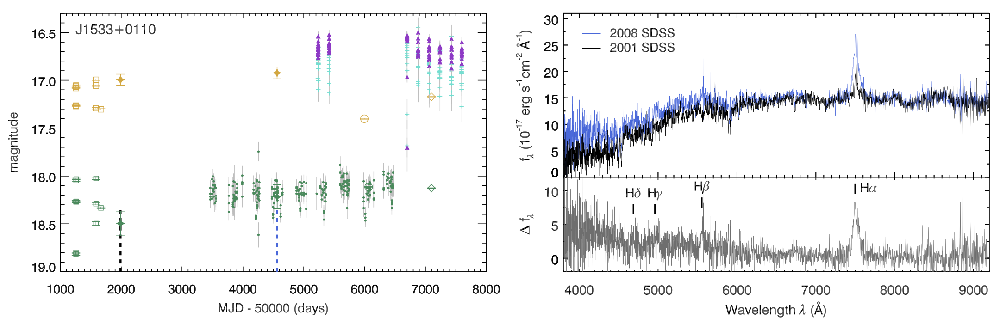

SDSSJ172322.30+550413.8  Potts&Villforth2021:


"The object J172322.31+550413.8 (hereafter referred to as J1723+5504), shown in the top panel of Fig. 2, transitioned from a type 1.83 to type 1 AGN in just 184 days (142 days in the rest frame). To our knowledge, this is the fastest observed changing- look behaviour in a distant AGN with quasar luminosity. In its first epoch the presence of a weak broad Hβ characterises J1723+5504 as an intermediate type 1.8. The Hβ and Hα broad lines clearly emerge by the second epoch. The broad Hβ and Hα are asymmetric in the bright-state epoch, with an extended red wing."

" The CLQ J1723+5504 transitioned from an intermediate type 1.8 AGN to a type 1 AGN in 184 days (142 in the rest frame); the fastest observed changing-look behaviour in a distant AGN with quasar luminosity."



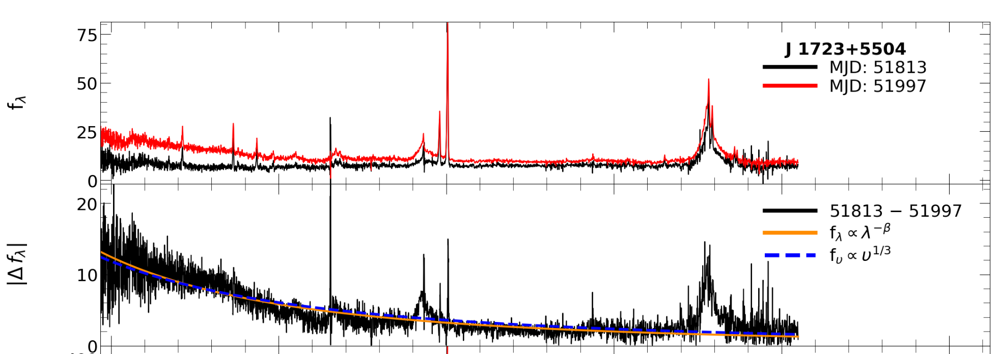

Neither is in S82... So try checking if they're in Schneider+2010:

In [8]:
import sys
sys.path.append('/Users/chris/GradResearch/kosmos/')
#import kosmos
 # need notebook backend for interaction
#%matplotlib notebook

import numpy as np
import matplotlib.pyplot as plt

# file-handling stuff for user, options abound! I like Tables and Pandas DataFrames
import pandas as pd
from astropy.table import Table
from astropy import units as u
from astropy.io import fits
import os
# import kosmos... if we do it right this should be the only other thing to import someday!
import sys  
sys.path.append('..')

import kosmos
kosmos.__version__

'0.1'

In [9]:
dr7 = Table.read('dr7qso_table.txt', format='ascii')

names = ['172322.31+550413.8','153355.99+011029.7']
m = np.in1d(dr7['SDSS_NAME'],names)
dr7[m]

SDR7ID,SDSS_NAME,RA,DEC,REDSHIFT
int64,str18,float64,float64,float64


ok, neither is in Schneider+2010. Perhaps we can get their single-epoch obs / spectra? 

In [337]:
from astroquery.mast import Mast
from astroquery.sdss import SDSS
names = ['172322.31+550413.8','153355.99+011029.7']

xids = {}
for name in names:
    coords = Mast.resolve_object(f'SDSSJ{name}')
    xid = SDSS.query_region(coords, radius='5 arcsec', spectro=True)
    xids[name] = xid

Both epochs mentioned by Potts-Villforth are returned: 

In [342]:
xids[names[0]]

ra,dec,objid,run,rerun,camcol,field,z,plate,mjd,fiberID,specobjid,run2d
float64,float64,int64,int64,int64,int64,int64,float64,int64,int64,int64,int64,int64
260.842955047931,55.0705072748618,1237651212825788429,1336,301,4,80,0.2944843,367,51997,172,413252578315364352,26
260.842955047931,55.0705072748618,1237651212825788429,1336,301,4,80,0.2946643,357,51813,162,401990827380860928,26


And for the second QSO - three epochs! 

In [341]:
# 153355 
xids[names[1]]

ra,dec,objid,run,rerun,camcol,field,z,plate,mjd,fiberID,specobjid,run2d
float64,float64,int64,int64,int64,int64,int64,float64,int64,int64,int64,int64,int64
233.48331533014,1.17494278582419,1237651735780393162,1458,301,2,726,0.142677,363,51989,575,408859754350274560,26
233.48331533014,1.17494278582419,1237651735780393162,1458,301,2,726,0.1426684,314,51641,561,353686804785817600,26
233.48331533014,1.17494278582419,1237651735780393162,1458,301,2,726,0.1428061,2954,54561,45,3325920770839832576,26


So we can get the sdss spectra for first QSO:

In [21]:
sdss_spectra = {}
sdss_spectra[names[0]] = SDSS.get_spectra(matches=xid)

and for the second:

In [121]:
sdss_spectra[names[1]] = SDSS.get_spectra(matches=xid)

In [319]:
np.save('SDSSJ172322_J153355_spectra.npy', sdss_spectra,)

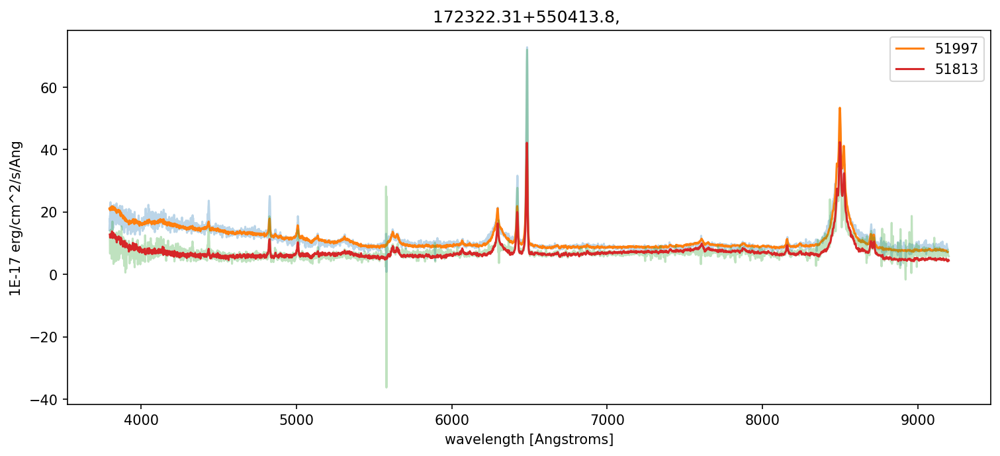

In [349]:
name = names[0]
sp = sdss_spectra[name]
fig,ax=  plt.subplots(1,1, figsize=(12,5), facecolor='w', dpi=150)
for i in range(2):
    mjd = sp[i][0].header['MJD']
    
    spec = sp[i][1].data
    
    ax.plot(np.power(10,spec['loglam']), spec['flux'], alpha=0.3)
    ax.plot(np.power(10,spec['loglam']), spec['model'], label=mjd)
    
ax.set_title(f'{name}, ')#mjd={mjd}',)
ax.set_xlabel('wavelength [Angstroms]')
ax.set_ylabel( sp[i][0].header['BUNIT'])
ax.legend()

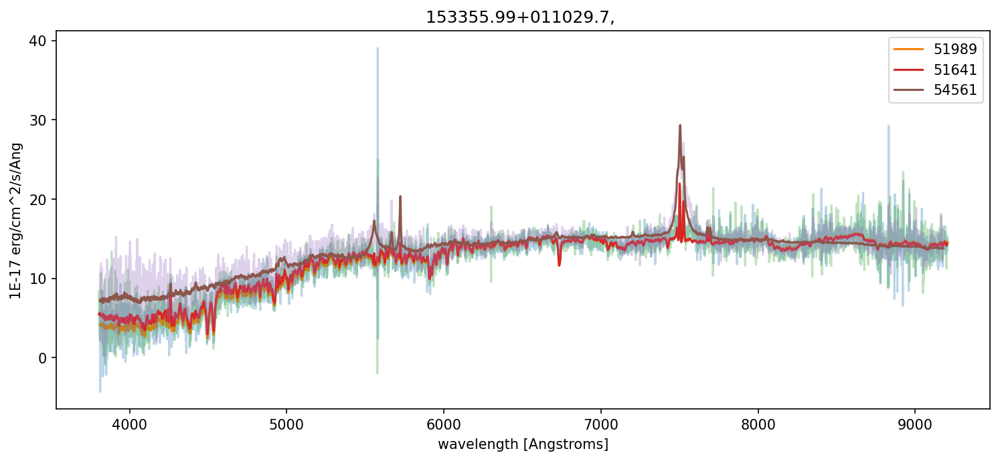

In [350]:
name = names[1]
sp = sdss_spectra[name]
fig,ax=  plt.subplots(1,1, figsize=(12,5), facecolor='w', dpi=150)
for i in range(3):
    mjd = sp[i][0].header['MJD']
    
    spec = sp[i][1].data
    
    ax.plot(np.power(10,spec['loglam']), spec['flux'], alpha=0.3)
    ax.plot(np.power(10,spec['loglam']), spec['model'], label=mjd)
    
ax.set_title(f'{name}, ')#mjd={mjd}',)
ax.set_xlabel('wavelength [Angstroms]')
ax.set_ylabel( sp[i][0].header['BUNIT'])
ax.legend()

Get photometry from DR16Q superset.. 

In [10]:
hdul = fits.open("DR16Q_Superset_v3.fits")
sdss_name = hdul[1].data['SDSS_NAME'] #
sdss_idx  = np.arange(len(sdss_name))
sdss_jid = names
select = np.in1d(sdss_name, sdss_jid)
select_idx = sdss_idx[select]
dr16q_select = Table(hdul[1].data[select_idx])

Nothing! Quite weird... Given that there are two epochs in 

In [13]:
sdss_name

chararray(['000000.04+064602.3', '000000.04+064602.3',
           '000000.05+272811.6', ..., '235959.90+031606.9',
           '235959.94+204315.8', '235959.98+344449.6'], dtype='<U18')

In [19]:
np.in1d('000000.04+064602.3', sdss_name)

array([ True])

Method works, but I don't understand why neither of these is in DR16Q... 

Try querying the SDSS server using coords 
https://skyserver.sdss.org/dr16/en/tools/search/radial.aspx

In [ ]:
'172322.31+550413.8'
(260.84293, 55.07053)

'153355.99+011029.7'
233.48331, 1.17494)

First query https://skyserver.sdss.org/dr16/en/tools/search/radial.aspx for (260.84293, 55.07053)

This query  https://skyserver.sdss.org/dr16/en/tools/search/x_results.aspx?searchtool=Radial&uband=&gband=&rband=&iband=&zband=&jband=&hband=&kband=&TaskName=Skyserver.Search.Radial&ReturnHtml=true&whichphotometry=optical&coordtype=equatorial&ra=260.84293&dec=55.07053&radius=0.1&min_u=0&max_u=20&min_g=0&max_g=20&min_r=0&max_r=20&min_i=0&max_i=20&min_z=0&max_z=20&min_j=0&max_j=20&min_h=0&max_h=20&min_k=0&max_k=20&format=html&TableName=&limit=10

points me to https://skyserver.sdss.org/DR16//en/tools/explore/summary.aspx?id=1237651212825788429 

If on https://skyserver.sdss.org/dr16/en/tools/search/radial.aspx I select CSV, it gives me a nice table.  




https://skyserver.sdss.org/dr15/en/help/docs/api.aspx#search

In [119]:
data = Table.read('SDSS_DR16_query_J17232231.csv', format='ascii')

This could be used as single-epoch photometyr, except I don't know which epoch! So again have to dig on the website... 

In [122]:
data

objid,run,rerun,camcol,field,obj,type,ra,dec,u,g,r,i,z,Err_u,Err_g,Err_r,Err_i,Err_z
int64,int64,int64,int64,int64,int64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
1237651212825788429,1336,301,4,80,13,3,260.842955047931,55.0705072748618,18.96518,18.67888,17.85779,17.58383,17.0033,0.03123442,0.01101513,0.008415149,0.009460844,0.02251002


The mjd for photometry is 51638 based on https://skyserver.sdss.org/DR16//en/tools/explore/summary.aspx?id=1237651212825788429 

Second, query for 233.48331, 1.17494. I get https://skyserver.sdss.org/DR16//en/tools/explore/summary.aspx?id=1237651735780393162 
    

In [123]:
data = Table.read('SDSS_DR16_query_J1355.csv', format='ascii')

In [125]:
data[0]

objid,run,rerun,camcol,field,obj,type,ra,dec,u,g,r,i,z,Err_u,Err_g,Err_r,Err_i,Err_z
int64,int64,int64,int64,int64,int64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
1237651735780393162,1458,301,2,726,202,3,233.48331533014,1.17494278582419,20.06769,18.34068,17.31202,16.83899,16.53043,0.09617797,0.01061459,0.00712821,0.006888417,0.01780162


MJD for that photometry is 51668 

# Get PS1 photometry : 

In [322]:
import pyvo as vo
import requests
import pylab
import json
# To allow display tweaks for wider response tables
from IPython.core.display import display
from IPython.core.display import HTML

# suppress unimportant unit warnings from many TAP services
import warnings
warnings.filterwarnings("ignore", module="astropy.io.votable.*")
warnings.filterwarnings("ignore", module="pyvo.utils.xml.elements")
TAP_service = vo.dal.TAPService("http://vao.stsci.edu/PS1DR2/tapservice.aspx")

results = {}
names = ['J172322.31+550413.8','J153355.99+011029.7']
for name in names :
    coords = Mast.resolve_object(f'SDSS{name}')
    ra,dec = coords.ra.value,coords.dec.value
    radius = 1.0/3600.0 # radius = 1 arcsec

    query = """
    SELECT objID, RAMean, DecMean, nDetections, ng, nr, ni, nz, ny, gMeanPSFMag, 
        rMeanPSFMag, iMeanPSFMag, zMeanPSFMag, yMeanPSFMag
    FROM dbo.MeanObjectView
    WHERE
    CONTAINS(POINT('ICRS', RAMean, DecMean),CIRCLE('ICRS',{},{},{}))=1
    AND nDetections > 1
    """.format(ra,dec,radius)
    print(query)

    job = TAP_service.run_async(query)
    TAP_results = job.to_table()
    results[name] = TAP_results

/var/folders/y_/cnss5hqs3nz9dv_dd28yzt040000gq/T/ipykernel_34009/2123418026.py:6: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display



    SELECT objID, RAMean, DecMean, nDetections, ng, nr, ni, nz, ny, gMeanPSFMag, 
        rMeanPSFMag, iMeanPSFMag, zMeanPSFMag, yMeanPSFMag
    FROM dbo.MeanObjectView
    WHERE
    CONTAINS(POINT('ICRS', RAMean, DecMean),CIRCLE('ICRS',260.84293,55.07053,0.0002777777777777778))=1
    AND nDetections > 1
    

    SELECT objID, RAMean, DecMean, nDetections, ng, nr, ni, nz, ny, gMeanPSFMag, 
        rMeanPSFMag, iMeanPSFMag, zMeanPSFMag, yMeanPSFMag
    FROM dbo.MeanObjectView
    WHERE
    CONTAINS(POINT('ICRS', RAMean, DecMean),CIRCLE('ICRS',233.48331,1.17494,0.0002777777777777778))=1
    AND nDetections > 1
    


In [328]:
results[names[0]]

objID,RAMean,DecMean,nDetections,ng,nr,ni,nz,ny,gMeanPSFMag,rMeanPSFMag,iMeanPSFMag,zMeanPSFMag,yMeanPSFMag
,deg,deg,,,,,,,mag,mag,mag,mag,mag
int64,float64,float64,int16,int16,int16,int16,int16,int16,float32,float32,float32,float32,float32
174082608429955307,260.842964518012,55.0705034158996,83,15,18,21,14,15,18.1772,18.0514,18.0382,17.4924,17.794


In [329]:
results[names[1]]

objID,RAMean,DecMean,nDetections,ng,nr,ni,nz,ny,gMeanPSFMag,rMeanPSFMag,iMeanPSFMag,zMeanPSFMag,yMeanPSFMag
,deg,deg,,,,,,,mag,mag,mag,mag,mag
int64,float64,float64,int16,int16,int16,int16,int16,int16,float32,float32,float32,float32,float32
109412334832990418,233.483313354583,1.17495370351237,76,14,15,22,11,14,18.8899,18.408,18.15,17.7883,17.6348


Each corresponds to a single object - get its photometry : 

In [330]:
detection = {}
for key in results.keys():
    objid = results[key]['objID'][0]
    query = """
    SELECT
        objID, detectID, Detection.filterID as filterID, Filter.filterType, obsTime, ra, dec,
        psfFlux, psfFluxErr, psfMajorFWHM, psfMinorFWHM, psfQfPerfect, 
        apFlux, apFluxErr, infoFlag, infoFlag2, infoFlag3
    FROM Detection
    NATURAL JOIN Filter
    WHERE objID={}
    ORDER BY filterID, obsTime
    """.format(objid)
    print(query)

    job = TAP_service.run_async(query)
    detection_TAP_results = job.to_table()
    detection[key] = detection_TAP_results


    SELECT
        objID, detectID, Detection.filterID as filterID, Filter.filterType, obsTime, ra, dec,
        psfFlux, psfFluxErr, psfMajorFWHM, psfMinorFWHM, psfQfPerfect, 
        apFlux, apFluxErr, infoFlag, infoFlag2, infoFlag3
    FROM Detection
    NATURAL JOIN Filter
    WHERE objID=174082608429955307
    ORDER BY filterID, obsTime
    

    SELECT
        objID, detectID, Detection.filterID as filterID, Filter.filterType, obsTime, ra, dec,
        psfFlux, psfFluxErr, psfMajorFWHM, psfMinorFWHM, psfQfPerfect, 
        apFlux, apFluxErr, infoFlag, infoFlag2, infoFlag3
    FROM Detection
    NATURAL JOIN Filter
    WHERE objID=109412334832990418
    ORDER BY filterID, obsTime
    


In [331]:
for key in detection.keys():
    data = detection[key]
    data['mag'] = -2.5*np.log10(data['psfFlux']) + 8.90
    data.write(f'SDSS{key}_PS1_MAST.txt', format='csv',
              overwrite=True)

In [332]:
for key in detection.keys():
    print(key)

172322.31+550413.8
J153355.99+011029.7


## ASIDE: Trying URLLIB with 

In [115]:
from urllib.request import urlopen
url = 'https://skyserver.sdss.org/dr16/en/tools/search/x_results.aspx?\
searchtool=Radial&uband=&gband=&rband=&iband=&zband=&\
jband=&hband=&kband=&TaskName=Skyserver.Search.Radial&\
format=csv&whichphotometry=optical&\
coordtype=equatorial&ra=260.84293&dec=55.07053&\
radius=0.1&min_u=0&max_u=20&min_g=0&max_g=20&min_r=0&max_r=20&\
min_i=0&max_i=20&min_z=0&max_z=20&min_j=0&max_j=20&\
min_h=0&max_h=20&min_k=0&max_k=20&format=html&TableName=&limit=10'


url2 = 'http://skyserver.sdss.org/dr15/SkyServerWS/SearchTools/\
RadialSearch?ra=258.2&dec=64&radius=4.1&whichway=equatorial&\
limit=10&format=csv&fp=none&uband=0,17&check_u=u&gband=0,15&check_g=g&whichquery=imaging'

    
sql = 'http://skyserver.sdss.org/dr15/SkyServerWS/SearchTools/\
SqlSearch?cmd=select%20top%2010%20ra,dec%20from%20Frame&format=csv'
data = urlopen(url)

In [116]:
data.read()

b'[\r\n  {\r\n    "TableName": "Table1",\r\n    "Rows": [\r\n      {\r\n        "objid": 1237651212825788429,\r\n        "run": 1336,\r\n        "rerun": 301,\r\n        "camcol": 4,\r\n        "field": 80,\r\n        "obj": 13,\r\n        "type": 3,\r\n        "ra": 260.842955047931,\r\n        "dec": 55.0705072748618,\r\n        "u": 18.96518,\r\n        "g": 18.67888,\r\n        "r": 17.85779,\r\n        "i": 17.58383,\r\n        "z": 17.0033,\r\n        "Err_u": 0.03123442,\r\n        "Err_g": 0.01101513,\r\n        "Err_r": 0.008415149,\r\n        "Err_i": 0.009460844,\r\n        "Err_z": 0.02251002\r\n      }\r\n    ]\r\n  },\r\n  {\r\n    "TableName": "SqlQuery",\r\n    "Rows": [\r\n      {\r\n        "query": "SELECT TOP 10 p.objid,\\n p.run, p.rerun, p.camcol, p.field, p.obj,\\n p.type, p.ra, p.dec, p.u,p.g,p.r,p.i,p.z,\\n p.Err_u, p.Err_g, p.Err_r,p.Err_i,p.Err_z\\n FROM fGetNearbyObjEq(260.84293,55.07053,0.1) n, PhotoPrimary p\\n WHERE n.objID=p.objID "\r\n      }\r\n    ]\r

ok, I can get HTML result, but how could I get CSV instead ? The guide https://skyserver.sdss.org/dr15/en/help/docs/api.aspx#search doesn't mention it, and DR16 doesn't seem to have a guide at all.... Pretty confusing ! 

Try getting anything from https://epyc.astro.washington.edu/~bsipocz/astroml/regression/_build/html/user_guide/datasets.html    

In [70]:
!pip install astroML -U

     |████████████████████████████████| 134 kB 216 kB/s eta 0:00:01
  Attempting uninstall: astroML
    Found existing installation: astroML 0.4.1
    Uninstalling astroML-0.4.1:
      Successfully uninstalled astroML-0.4.1


In [73]:
import importlib as imp
imp.reload(astroML)

NameError: name 'astroML' is not defined

In [80]:
import astroML
imp.reload(astroML)

<module 'astroML' from '/Users/chris/anaconda3/lib/python3.8/site-packages/astroML/__init__.py'>

In [81]:
astroML.__version__

'1.0.2'

In [82]:
from astroML.datasets import fetch_dr7_quasar
data = fetch_dr7_quasar()  

In [38]:
np.in1d(names,data['sdssID'])

array([False, False])

In [44]:
m1 = np.abs(data['RA'] - 260.84293)<0.1
m2 = np.abs(data['dec']-55.07053)<0.1
m = m1&m2
data[m]

array([],
      dtype=[('sdssID', 'S14'), ('RA', '<f8'), ('dec', '<f8'), ('redshift', '<f4'), ('mag_u', '<f4'), ('err_u', '<f4'), ('mag_g', '<f4'), ('err_g', '<f4'), ('mag_r', '<f4'), ('err_r', '<f4'), ('mag_i', '<f4'), ('err_i', '<f4'), ('mag_z', '<f4'), ('err_z', '<f4'), ('mag_J', '<f4'), ('err_J', '<f4'), ('mag_H', '<f4'), ('err_H', '<f4'), ('mag_K', '<f4'), ('err_K', '<f4'), ('specobjid', '<i8')])

In [45]:
m1 = np.abs(data['RA'] - 233.48331)<0.1
m2 = np.abs(data['dec']-1.17494)<0.1
m = m1&m2
data[m]

array([],
      dtype=[('sdssID', 'S14'), ('RA', '<f8'), ('dec', '<f8'), ('redshift', '<f4'), ('mag_u', '<f4'), ('err_u', '<f4'), ('mag_g', '<f4'), ('err_g', '<f4'), ('mag_r', '<f4'), ('err_r', '<f4'), ('mag_i', '<f4'), ('err_i', '<f4'), ('mag_z', '<f4'), ('err_z', '<f4'), ('mag_J', '<f4'), ('err_J', '<f4'), ('mag_H', '<f4'), ('err_H', '<f4'), ('mag_K', '<f4'), ('err_K', '<f4'), ('specobjid', '<i8')])

Simply not there! I wonder what's going on ... These two QSOs are not in DR7.

Try executing query directly  just like this astroML code does https://epyc.astro.washington.edu/~bsipocz/astroml/regression/_build/html/_modules/astroML/datasets/sdss_galaxy_colors.html#fetch_sdss_galaxy_colors



In [50]:
from astroML.datasets.tools import sql_query

In [55]:
sql_query()

In [83]:
from astroML.datasets import fetch_sdss_galaxy_colors

In [128]:
#data = astroML.datasets.fetch_sdss_galaxy_colors()

This url  http://cas.sdss.org/public/en/tools/search/x_sql.aspx seems outdated. 

# 0. Fix all headers 

In [130]:
path = '/Users/chris/GradResearch/Q2UW06/UT230428/'
file_names = os.listdir(path)
file_paths = [os.path.join(path,fname) for fname in file_names]
kwds_dic = {'GAIN':0.6, 'DATASEC':'[1:2048, 1:4096]' , 'RDNOISE':6}

for file in file_paths:
    hdul = fits.open(file)
    for kw in kwds_dic.keys():
        if kw in dict(hdul[0].header).keys():
            continue
        else:
            print(f'{kw} is missing ')
            ofile = fits.open(file, mode='update')
            value = kwds_dic[kw]
            ofile[0].header[kw] = value
            print(f'Updated, adding {kw}:{value}')
            ofile.flush()
            ofile.close()

GAIN is missing 
Updated, adding GAIN:0.6
DATASEC is missing 
Updated, adding DATASEC:[1:2048, 1:4096]
RDNOISE is missing 
Updated, adding RDNOISE:6
GAIN is missing 
Updated, adding GAIN:0.6
DATASEC is missing 
Updated, adding DATASEC:[1:2048, 1:4096]
RDNOISE is missing 
Updated, adding RDNOISE:6
GAIN is missing 
Updated, adding GAIN:0.6
DATASEC is missing 
Updated, adding DATASEC:[1:2048, 1:4096]
RDNOISE is missing 
Updated, adding RDNOISE:6
GAIN is missing 
Updated, adding GAIN:0.6
DATASEC is missing 
Updated, adding DATASEC:[1:2048, 1:4096]
RDNOISE is missing 
Updated, adding RDNOISE:6
GAIN is missing 
Updated, adding GAIN:0.6
DATASEC is missing 
Updated, adding DATASEC:[1:2048, 1:4096]
RDNOISE is missing 
Updated, adding RDNOISE:6
GAIN is missing 
Updated, adding GAIN:0.6
DATASEC is missing 
Updated, adding DATASEC:[1:2048, 1:4096]
RDNOISE is missing 
Updated, adding RDNOISE:6
GAIN is missing 
Updated, adding GAIN:0.6
DATASEC is missing 
Updated, adding DATASEC:[1:2048, 1:4096]
RDN

# 1. Bias  Combine

In [131]:
biasfnames = [file for file in files if file.startswith('bias')]
biasfiles = [os.path.join(path,fname) for fname in biasfnames]

In [133]:
bias = kosmos.biascombine(biasfiles)

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


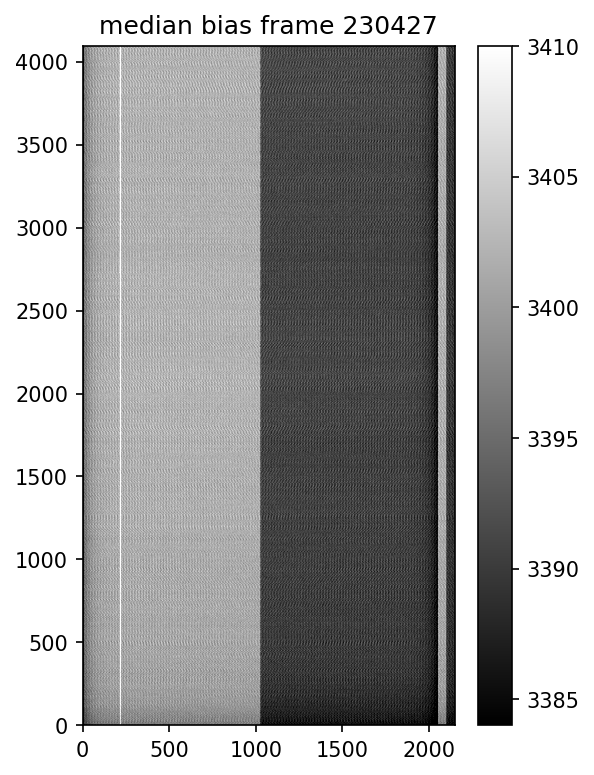

In [376]:
%matplotlib inline
plt.figure(figsize=(4,6), dpi=150, facecolor='w')
plt.imshow(bias, origin='lower', aspect='auto', cmap=plt.cm.gray)
plt.title('median bias frame 230427')
plt.clim(np.percentile(bias, (5, 98)))
cb = plt.colorbar()

I have no idea why suddenly bias looks so much different day to day ... ? 

# 2. Flat 

In [135]:
fnames =  [file for file in files if file.startswith('flat_red')]
flat_red_fpaths = [os.path.join(path,fname) for fname in fnames]

fnames =  [file for file in files if file.startswith('flat_blue')]
flat_blue_fpaths = [os.path.join(path,fname) for fname in fnames]


In [136]:
flat_red_fpaths

['/Users/chris/GradResearch/Q2UW06/UT230428/flat_red_int.0011.fits',
 '/Users/chris/GradResearch/Q2UW06/UT230428/flat_red_int.0010.fits',
 '/Users/chris/GradResearch/Q2UW06/UT230428/flat_red_int.0009.fits',
 '/Users/chris/GradResearch/Q2UW06/UT230428/flat_red_int.0013.fits',
 '/Users/chris/GradResearch/Q2UW06/UT230428/flat_red_int.0012.fits']

In [137]:
flat_blue_fpaths

['/Users/chris/GradResearch/Q2UW06/UT230428/flat_blue_int.0017.fits',
 '/Users/chris/GradResearch/Q2UW06/UT230428/flat_blue_int.0016.fits',
 '/Users/chris/GradResearch/Q2UW06/UT230428/flat_blue_int.0015.fits',
 '/Users/chris/GradResearch/Q2UW06/UT230428/flat_blue_int.0018.fits',
 '/Users/chris/GradResearch/Q2UW06/UT230428/flat_blue_int.0014.fits']

In [138]:
flat_red, ilum_red = kosmos.flatcombine(flat_red_fpaths,
                                       bias=bias, Saxis=1)

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
/Users/chris/anaconda3/lib/python3.8/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


In [139]:
flat_blue, ilum_blue = kosmos.flatcombine(flat_blue_fpaths,
                                       bias=bias, Saxis=1)

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
/Users/chris/anaconda3/lib/python3.8/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


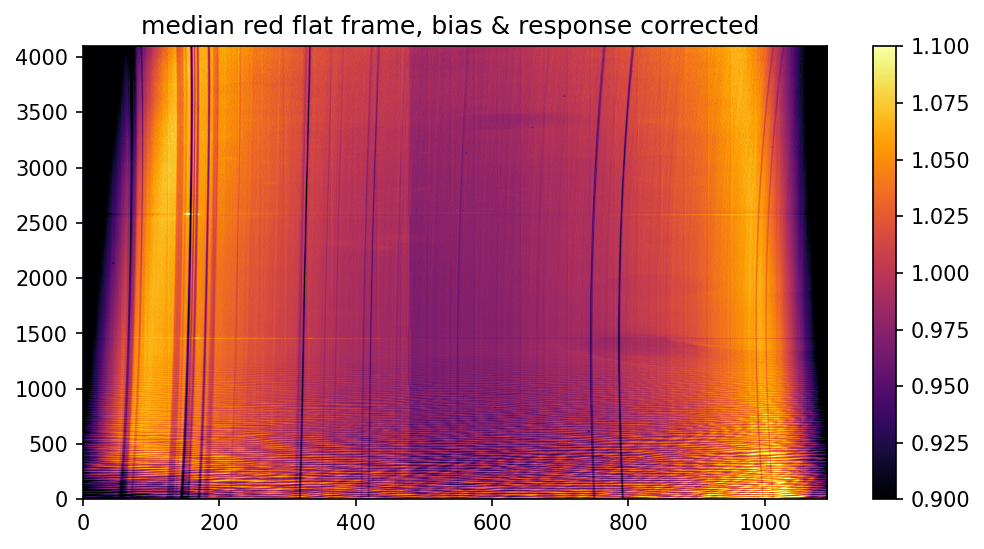

In [140]:
%matplotlib inline
fig, ax = plt.subplots(1,1, figsize=(8, 4), dpi=150,  facecolor='w')
im = ax.imshow(flat_red, origin='lower', aspect='auto', 
               cmap=plt.cm.inferno, vmin=0.9, vmax=1.1)
ax.set_title('median red flat frame, bias & response corrected ')
plt.colorbar(mappable=im, ax=ax)


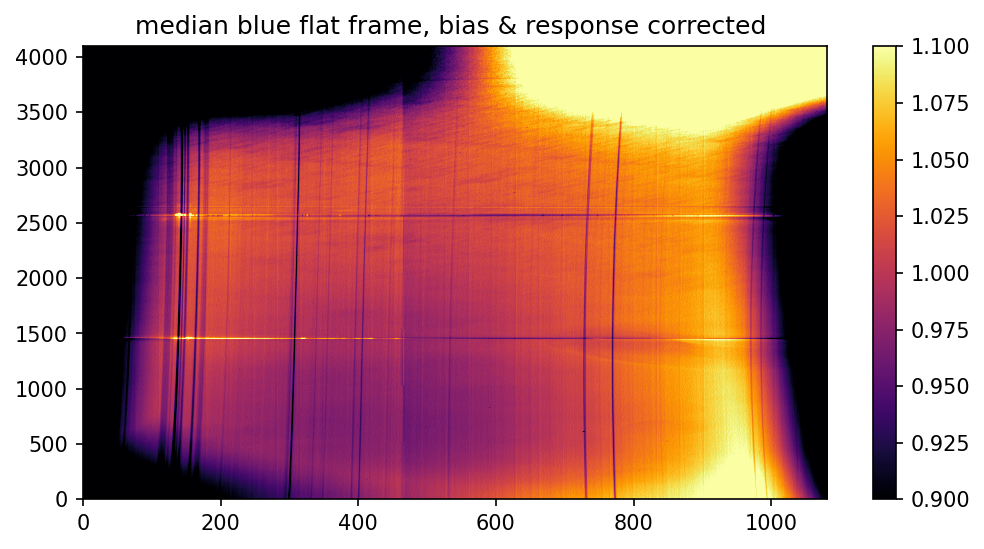

In [141]:
%matplotlib inline
fig, ax = plt.subplots(1,1, figsize=(8, 4), dpi=150,  facecolor='w')
im = ax.imshow(flat_blue, origin='lower', aspect='auto', 
               cmap=plt.cm.inferno, vmin=0.9, vmax=1.1)
ax.set_title('median blue flat frame, bias & response corrected ')
plt.colorbar(mappable=im, ax=ax)


Wow, what's going on with this flat?? 

# 2D reduction

This time the same standard star was taken twice: before the first QSO  and before the second QSO. I don't know - for now treat it as two separate stars.. 

In [144]:
fnames =  [file for file in files if file.startswith('HR5501_red')]
std_red1= [os.path.join(path,fname) for fname in fnames]

fnames =  [file for file in files if file.startswith('HR5501_blue')]
std_blue1= [os.path.join(path,fname) for fname in fnames]

In [145]:
fnames =  [file for file in files if file.startswith('hr5501_red')]
std_red2= [os.path.join(path,fname) for fname in fnames]

fnames =  [file for file in files if file.startswith('hr5501_blue')]
std_blue2= [os.path.join(path,fname) for fname in fnames]


In [146]:
std_red1

['/Users/chris/GradResearch/Q2UW06/UT230428/HR5501_red.0032.fits',
 '/Users/chris/GradResearch/Q2UW06/UT230428/HR5501_red.0033.fits',
 '/Users/chris/GradResearch/Q2UW06/UT230428/HR5501_red.0031.fits']

In [147]:
std_red2

['/Users/chris/GradResearch/Q2UW06/UT230428/hr5501_red.0042.fits']

In [148]:
from astropy.visualization import ZScaleInterval
zscale = ZScaleInterval()


def plot_spec_trace(hdul,fname):
    fig = plt.figure(figsize=(8, 4),dpi=150,  facecolor='w')
    left, bottom, width, height = 0,0.1,1,0.9
    ax = fig.add_axes([left,bottom,width,height])
    exp = hdul[0].header['EXPTIME']
    data = hdul[0].data
    maxcount = np.max(data)
    ax.set_title(f'{fname}, {exp} s, max {maxcount} counts')
    vmin,vmax = zscale.get_limits(data)
    ax.imshow(data,vmin=vmin, vmax=vmax, origin='lower',aspect='auto')

    # right hand side 
    ax1 = fig.add_axes([1,bottom,0.2,height], yticks=[])# sharex=True)
    line = data[:,1000]
    ax1.plot(line, np.arange(len(line)), )
    
    

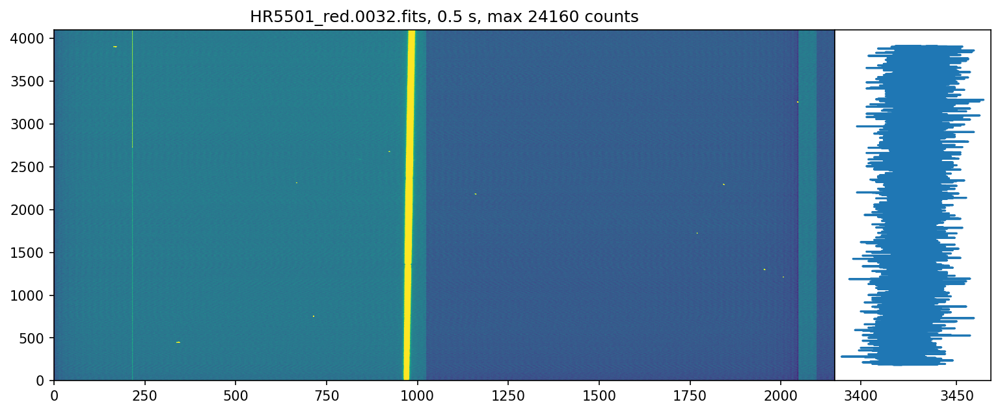

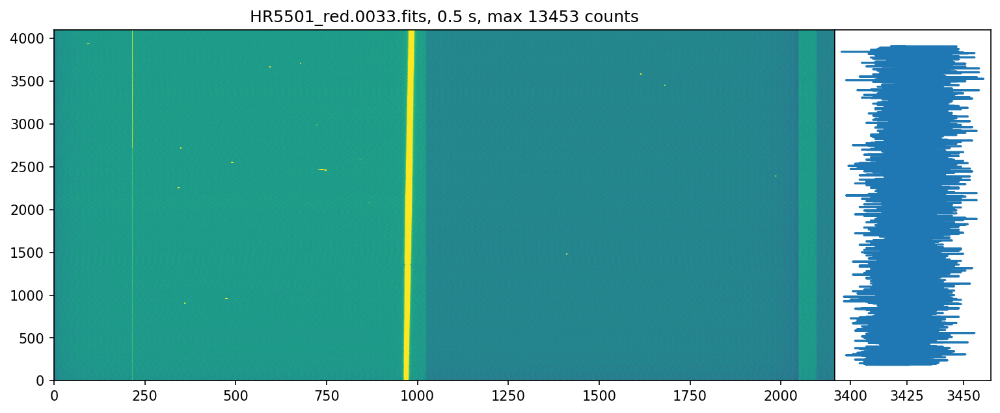

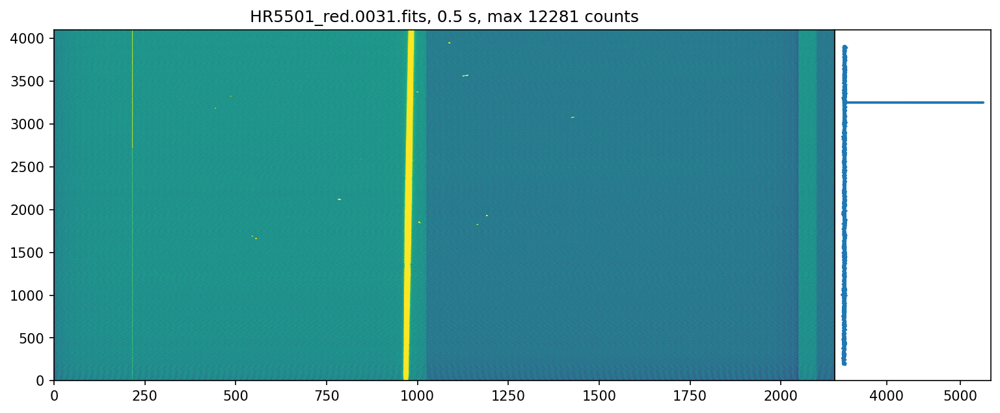

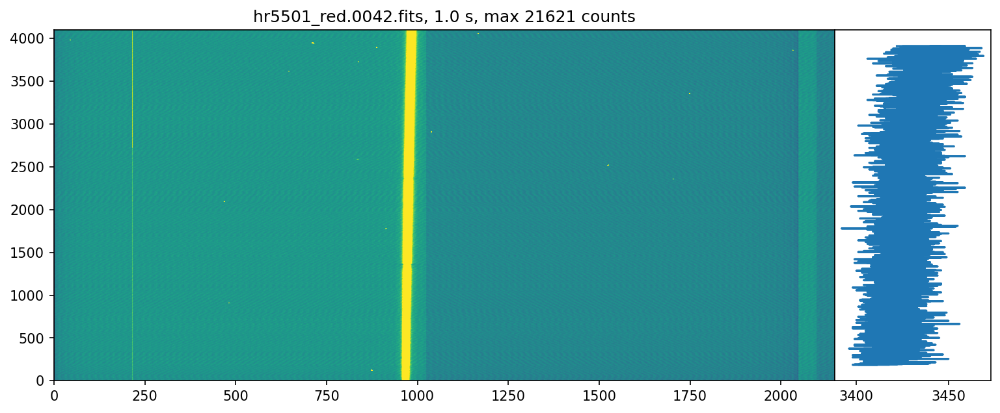

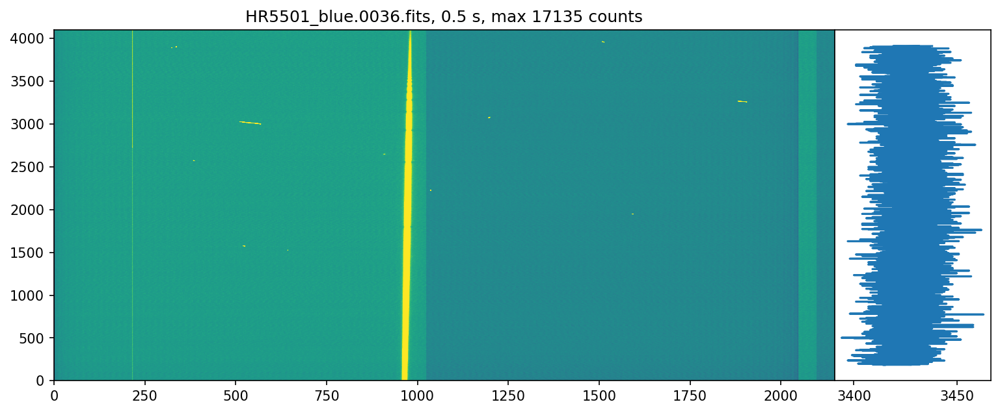

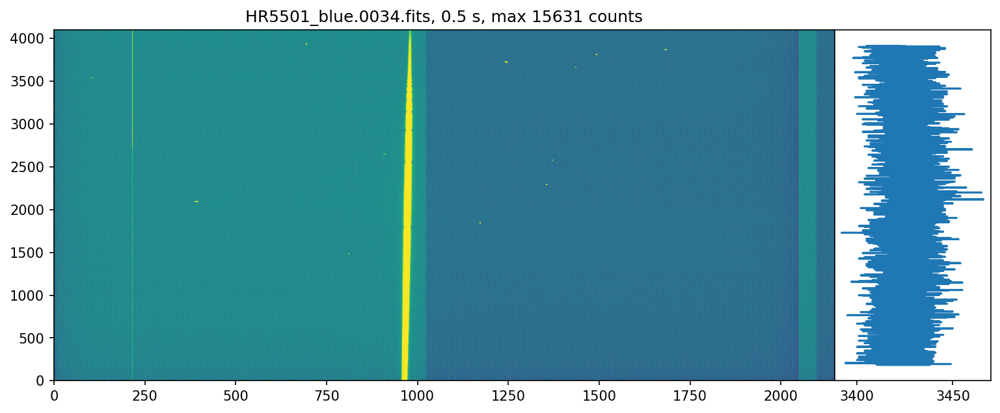

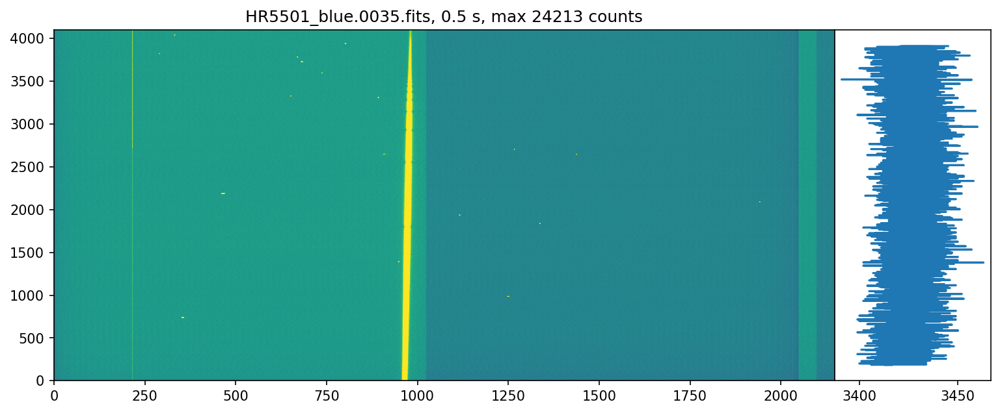

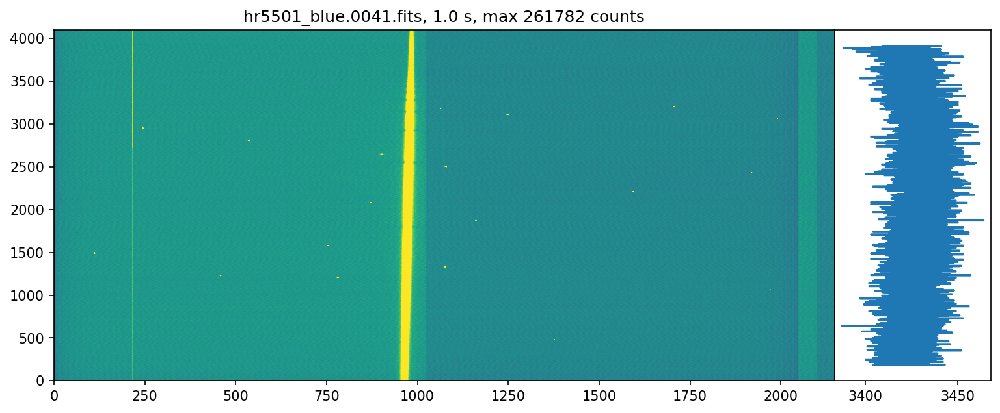

In [149]:
for flist in [std_red1, std_red2, std_blue1, std_blue2]:
    for i in range(len(flist)):
        hdul = fits.open(flist[i])
        fname = flist[i].split('/')[-1]
        plot_spec_trace(hdul,fname)
   

Just pick one of each ... 

In [153]:
std_red1[0]

'/Users/chris/GradResearch/Q2UW06/UT230428/HR5501_red.0032.fits'

In [154]:
std_blue1[0]

'/Users/chris/GradResearch/Q2UW06/UT230428/HR5501_blue.0036.fits'

In [156]:
std_red2[0]

'/Users/chris/GradResearch/Q2UW06/UT230428/hr5501_red.0042.fits'

In [157]:
# Just pick one of each of the exp of the first star...

std_red1_2d = kosmos.proc(std_red1[0], bias=bias, 
                                ilum=ilum_red, 
                            flat=flat_red, trim=True, Saxis=1)

std_red2_2d = kosmos.proc(std_red2[0], bias=bias, 
                                ilum=ilum_red, 
                            flat=flat_red, trim=True, Saxis=1)

std_blue1_2d = kosmos.proc(std_blue1[0], bias=bias, 
                               ilum=ilum_blue, 
                            flat=flat_blue, trim=True, Saxis=1)

std_blue2_2d = kosmos.proc(std_blue2[0], bias=bias, 
                                ilum=ilum_blue, 
                             flat=flat_blue, trim=True, Saxis=1)



the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


In [159]:
fnames =  [file for file in files if file.startswith('J153355_red')]
qso1_red = [os.path.join(path,fname) for fname in fnames]

fnames =  [file for file in files if file.startswith('J153355_blue')]
qso1_blue = [os.path.join(path,fname) for fname in fnames]


fnames =  [file for file in files if file.startswith('J172322_red')]
qso2_red = [os.path.join(path,fname) for fname in fnames]

fnames =  [file for file in files if file.startswith('J172322_blue')]
qso2_blue = [os.path.join(path,fname) for fname in fnames]

In [163]:
qso1_red

['/Users/chris/GradResearch/Q2UW06/UT230428/J153355_red.0039.fits',
 '/Users/chris/GradResearch/Q2UW06/UT230428/J153355_red.0038.fits']

In [160]:
qso2_red

['/Users/chris/GradResearch/Q2UW06/UT230428/J172322_red.0043.fits']

In [161]:
qso2_blue

['/Users/chris/GradResearch/Q2UW06/UT230428/J172322_blue.0045.fits',
 '/Users/chris/GradResearch/Q2UW06/UT230428/J172322_blue.0044.fits']

In [162]:
qso1_red_2d = {}
qso1_blue_2d = {}

qso2_red_2d = {}
qso2_blue_2d = {}

for i in range(2):
    qso1_red_2d[i] = kosmos.proc(qso1_red[i], bias=bias, 
                                    ilum=ilum_red, flat=flat_red, trim=True,
                    Saxis=1, CR=True)
    
    qso1_blue_2d[i] = kosmos.proc(qso1_blue[i], bias=bias, 
                                    ilum=ilum_blue, flat=flat_blue, trim=True,
                    Saxis=1, CR=True)
    
    qso2_blue_2d[i] = kosmos.proc(qso2_blue[i], bias=bias, 
                                    ilum=ilum_blue, flat=flat_blue, trim=True,
                    Saxis=1, CR=True)
    
for i in range(1):
    qso2_red_2d[i] = kosmos.proc(qso2_red[i], bias=bias, 
                                    ilum=ilum_red, flat=flat_red, trim=True,
                    Saxis=1, CR=True)


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: overwriting Masked Objects's current mask with specified mask. [astropy.nddata.nddata]


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: overwriting Masked Objects's current mask with specified mask. [astropy.nddata.nddata]


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: overwriting Masked Objects's current mask with specified mask. [astropy.nddata.nddata]


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: overwriting Masked Objects's current mask with specified mask. [astropy.nddata.nddata]


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: overwriting Masked Objects's current mask with specified mask. [astropy.nddata.nddata]


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: overwriting Masked Objects's current mask with specified mask. [astropy.nddata.nddata]


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: overwriting Masked Objects's current mask with specified mask. [astropy.nddata.nddata]


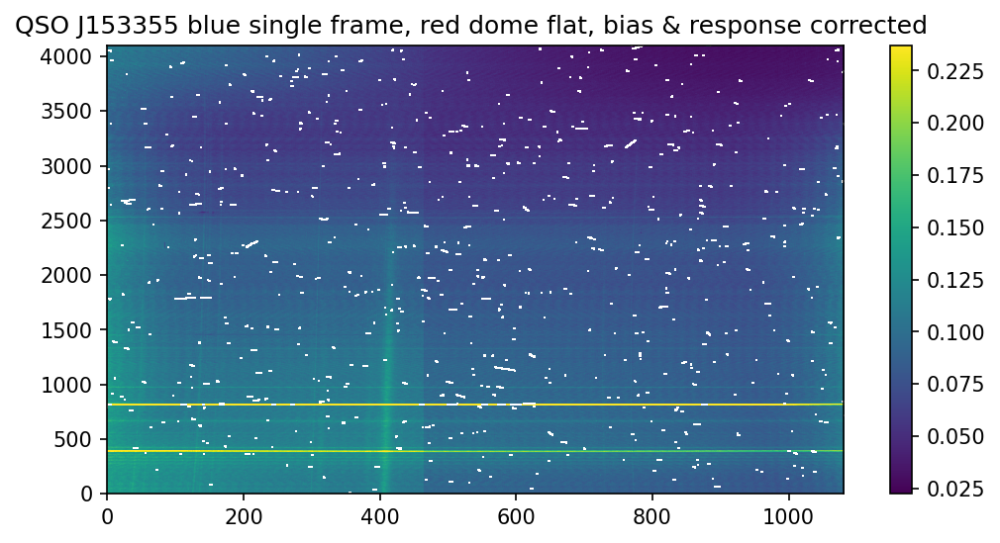

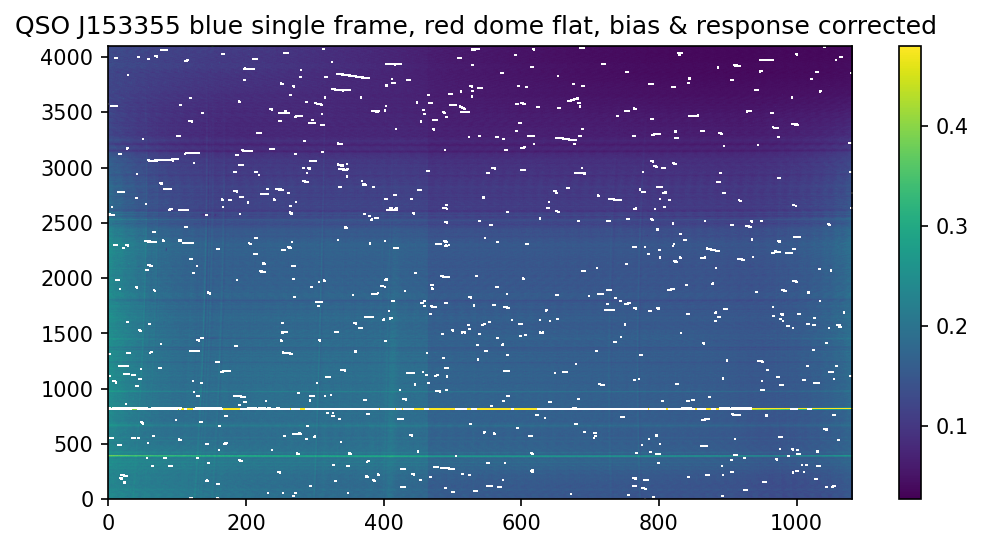

In [166]:
for i in range(len(qso1_blue_2d)):
    fig, ax = plt.subplots(1,1, figsize=(8, 4), dpi=150, facecolor='w')
    data = qso1_blue_2d[i]
    vmin,vmax = zscale.get_limits(data)
    im = ax.imshow(data, vmin=vmin,vmax=vmax,origin='lower', aspect='auto', )#cmap=plt.cm.inferno)#,vmin=0.9, vmax=1.1)
    ax.set_title('QSO J153355 blue single frame, red dome flat, bias & response corrected ')
    plt.colorbar(mappable=im, ax=ax)


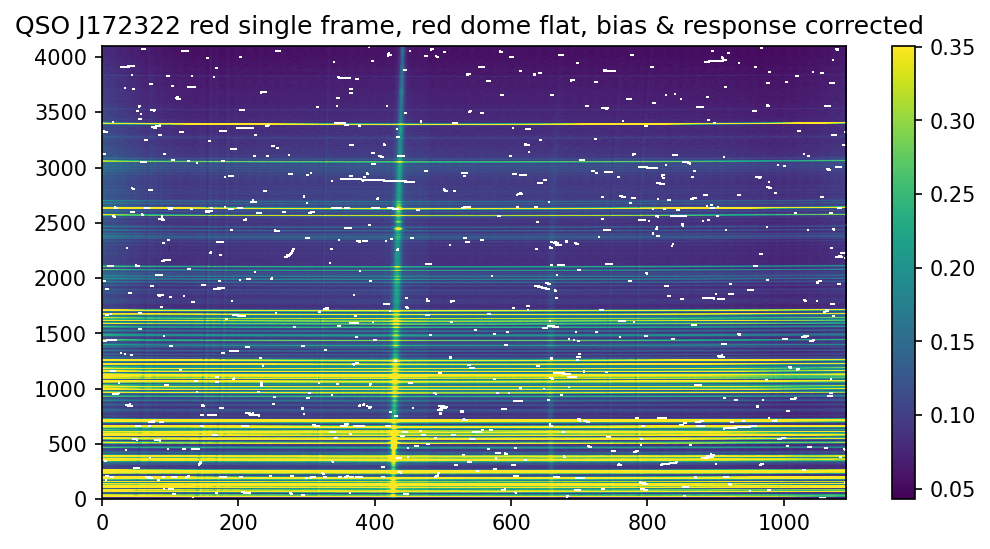

In [167]:
for i in range(len(qso2_red_2d)):
    fig, ax = plt.subplots(1,1, figsize=(8, 4), dpi=150, facecolor='w')
    data = qso2_red_2d[i]
    vmin,vmax = zscale.get_limits(data)
    im = ax.imshow(data, vmin=vmin,vmax=vmax,origin='lower', aspect='auto', )#cmap=plt.cm.inferno)#,vmin=0.9, vmax=1.1)
    ax.set_title('QSO J172322 red single frame, red dome flat, bias & response corrected ')
    plt.colorbar(mappable=im, ax=ax)


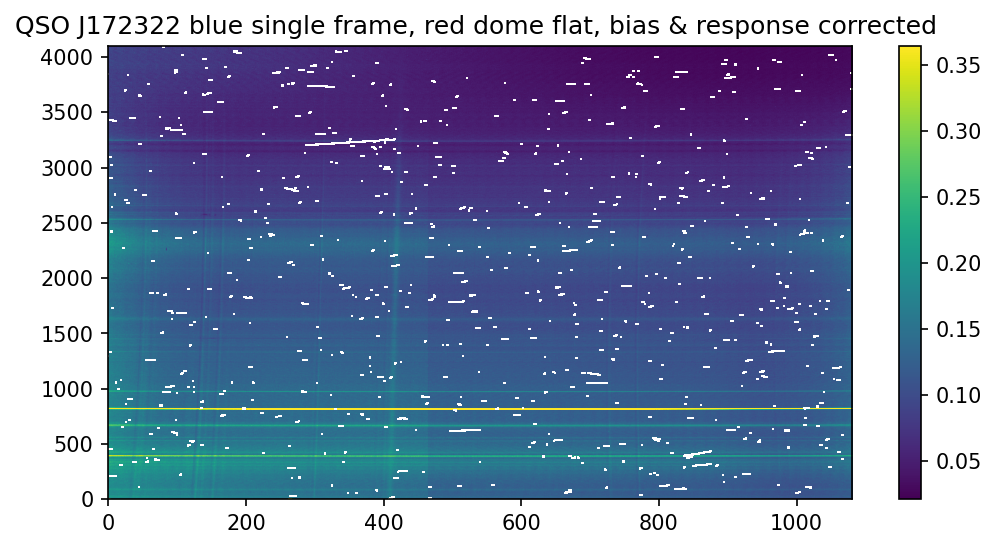

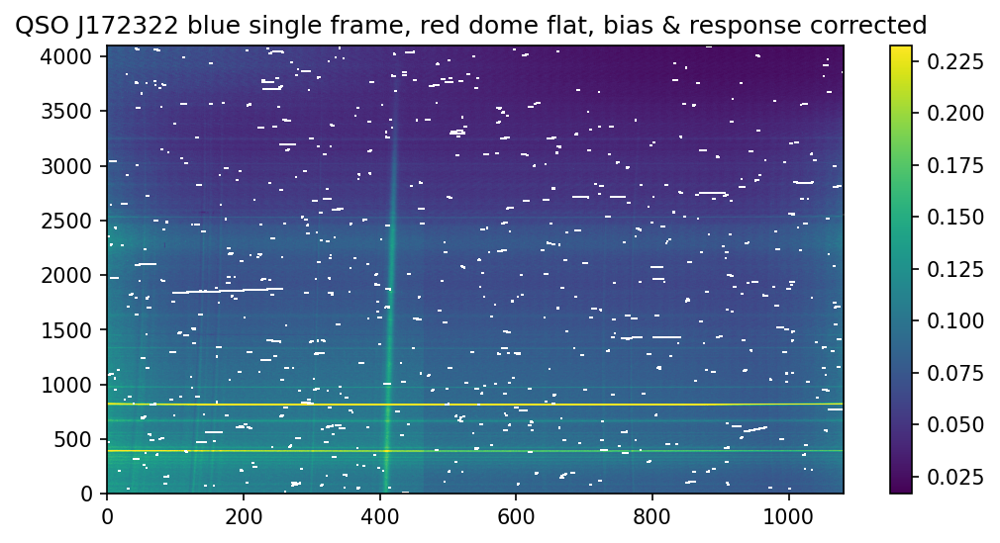

In [168]:
for i in range(len(qso2_blue_2d)):
    fig, ax = plt.subplots(1,1, figsize=(8, 4), dpi=150, facecolor='w')
    data = qso2_blue_2d[i]
    vmin,vmax = zscale.get_limits(data)
    im = ax.imshow(data, vmin=vmin,vmax=vmax,origin='lower', aspect='auto', )#cmap=plt.cm.inferno)#,vmin=0.9, vmax=1.1)
    ax.set_title('QSO J172322 blue single frame, red dome flat, bias & response corrected ')
    plt.colorbar(mappable=im, ax=ax)


The second exposure is cleaner, b/c it has less clouds... 

# 2D wavelength cals 

(all internal this time) 

* blue krypton low 
* red krypton low 
* blue neon low 
* red neon low 

In [169]:
fnames =  [file for file in files if file.startswith('blue_krypton_int')]
blue_krypton_fpaths = [os.path.join(path,fname) for fname in fnames]

fnames =  [file for file in files if file.startswith('red_krypton_int')]
red_krypton_fpaths = [os.path.join(path,fname) for fname in fnames]

fnames =  [file for file in files if file.startswith('blue_neon_int')]
blue_neon_fpaths = [os.path.join(path,fname) for fname in fnames]

fnames =  [file for file in files if file.startswith('red_neon_int')]
red_neon_fpaths = [os.path.join(path,fname) for fname in fnames]


In [171]:
red_neon_2d = {}
blue_neon_2d = {}

red_krypton_2d = {}
blue_krypton_2d = {}

for i in range(3): # 2 exposures 
    red_neon_2d[i] = kosmos.proc(red_neon_fpaths[i], bias=bias, ilum=ilum_red,
                          flat=flat_red, trim=True,
                          Saxis=1, CR=False)
    red_krypton_2d[i] = kosmos.proc(red_krypton_fpaths[i], bias=bias, ilum=ilum_red,
                          flat=flat_red, trim=True,
                          Saxis=1, CR=False)
    
    blue_neon_2d[i] = kosmos.proc(blue_neon_fpaths[i], bias=bias, ilum=ilum_blue,
                          flat=flat_blue, trim=True,
                          Saxis=1, CR=False)
    blue_krypton_2d[i] = kosmos.proc(blue_krypton_fpaths[i], bias=bias, ilum=ilum_blue,
                          flat=flat_blue, trim=True,
                          Saxis=1, CR=False)
    
   

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


# Trace & Extract

In [173]:
std_red1_2d

CCDData([[ 76.98130828,  40.63480318,  43.88840434, ...,  79.39005758,
           96.11892681,  40.06841809],
         [ 67.33163971,  62.00137039,  42.07002012, ...,  38.41974649,
           52.58825685,  49.60161613],
         [ 46.82330905,  57.75203808,  61.87113061, ...,  40.1984093 ,
           24.2184787 ,  20.48982275],
         ...,
         [ 55.57065437,  66.95549467,  87.79766137, ...,  44.00634485,
           71.87042747,  35.15461846],
         [ 11.15585086, 110.21842149,  54.12760926, ...,  60.82532536,
           14.76285488,  19.97040274],
         [ 92.0229086 ,  54.25373665,  69.26643425, ...,  91.56296342,
           72.26504347,  68.75272574]], unit='adu / s')

/Users/chris/anaconda3/lib/python3.8/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


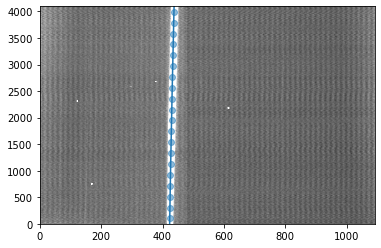

In [175]:
fig, ax = plt.subplots(1,1)
std_red1_trace = kosmos.trace(std_red1_2d, display=True, ax=ax, Saxis=1,
                             guess=400, window=50)

/Users/chris/anaconda3/lib/python3.8/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


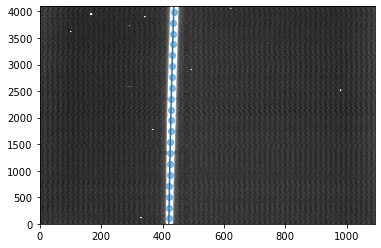

In [176]:
fig, ax = plt.subplots(1,1)
std_red2_trace = kosmos.trace(std_red2_2d, display=True, ax=ax, Saxis=1,
                             guess=400, window=50)

/Users/chris/anaconda3/lib/python3.8/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


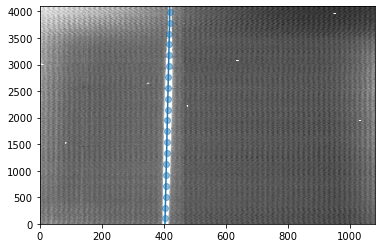

In [180]:
fig, ax = plt.subplots(1,1)
std_blue1_trace = kosmos.trace(std_blue1_2d, display=True, ax=ax, Saxis=1,
                             guess=400, window=50)

/Users/chris/anaconda3/lib/python3.8/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


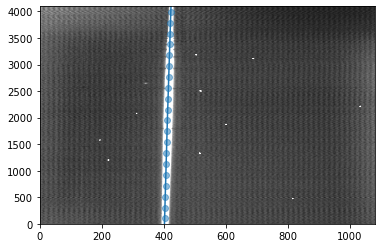

In [179]:
fig, ax = plt.subplots(1,1)
std_blue2_trace = kosmos.trace(std_blue2_2d, display=True, ax=ax, Saxis=1,
                             guess=400, window=50)

In [181]:

std1_red_1d, std1_red_sky = kosmos.BoxcarExtract(std_red1_2d, std_red1_trace, 
                                                   display=True, ax=ax, 
                                                  Saxis=1,apwidth=15)
std2_red_1d, std2_red_sky = kosmos.BoxcarExtract(std_red2_2d, std_red2_trace, 
                                                   display=True, ax=ax, 
                                                  Saxis=1,apwidth=15)

std1_blue_1d, std1_blue_sky = kosmos.BoxcarExtract(std_blue1_2d, std_blue1_trace, 
                                               display=True, ax=ax, 
                                              Saxis=1,apwidth=15)

std2_blue_1d, std2_blue_sky = kosmos.BoxcarExtract(std_blue2_2d, std_blue2_trace, 
                                               display=True, ax=ax, 
                                              Saxis=1,apwidth=15)


zscale vmin,vmax:0.06791912460478153,0.38423048483647737


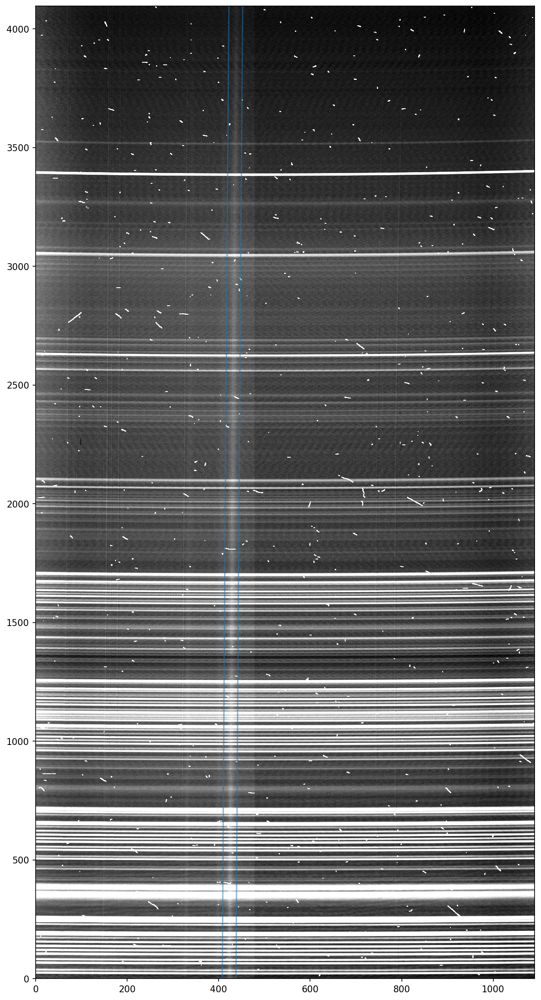

In [186]:
def plot_image_trace(img, trace_line, apwidth=15, use_zscale=True, vmin=0, vmax=0.3):
    fig,ax = plt.subplots(1,1, figsize=(10,20), dpi=150)
    zscale = ZScaleInterval()
    if use_zscale:
        vmin, vmax=  zscale.get_limits(img)
        print(f'zscale vmin,vmax:{vmin},{vmax}')
    im = ax.imshow(img, vmin=vmin, vmax=vmax, origin='lower', aspect='auto', cmap=plt.cm.Greys_r)
    #im.set_clim(np.percentile(img, (5, 98)))
    #ax.plot(trace_line, np.arange(len(trace_line)), c='C0')
    ax.plot(trace_line + apwidth, np.arange(len(trace_line)), c='C0', alpha=0.5)
    ax.plot(trace_line - apwidth, np.arange(len(trace_line)), c='C0', alpha=0.5)
    
    
plot_image_trace(qso1_red_2d[0], std_red1_trace)#+5)

In [189]:
qso1_red_1d = {}
qso1_red_sky = {}
for i in range(2):
    qso1_red_1d[i], qso1_red_sky[i] = kosmos.BoxcarExtract(qso1_red_2d[i], std_red1_trace, 
                                                   display=True, ax=ax, 
                                                  Saxis=1,apwidth=15)

/Users/chris/GradResearch/kosmos/kosmos/apextract.py:335: RuntimeWarning: invalid value encountered in sqrt
  fluxerr[i] = np.sqrt(np.nansum((onedspec[i]-skysubflux[i])) +
/Users/chris/GradResearch/kosmos/kosmos/apextract.py:335: RuntimeWarning: invalid value encountered in sqrt
  fluxerr[i] = np.sqrt(np.nansum((onedspec[i]-skysubflux[i])) +


zscale vmin,vmax:0.04277153578606355,0.3502878282041203


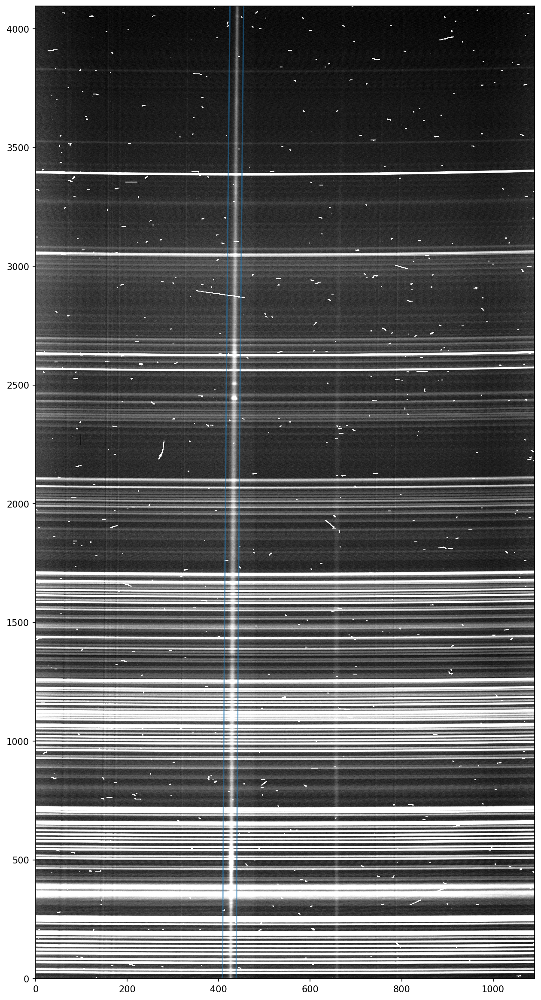

In [188]:
plot_image_trace(qso2_red_2d[0], std_red2_trace+3)

In [190]:
qso2_red_1d = {}
qso2_red_sky = {}
for i in range(1):
    qso2_red_1d[i], qso2_red_sky[i] = kosmos.BoxcarExtract(qso2_red_2d[i], std_red2_trace+3, 
                                                   display=True, ax=ax, 
                                                  Saxis=1,apwidth=15)

/Users/chris/GradResearch/kosmos/kosmos/apextract.py:335: RuntimeWarning: invalid value encountered in sqrt
  fluxerr[i] = np.sqrt(np.nansum((onedspec[i]-skysubflux[i])) +


zscale vmin,vmax:0.02239332866585965,0.23686203229981007


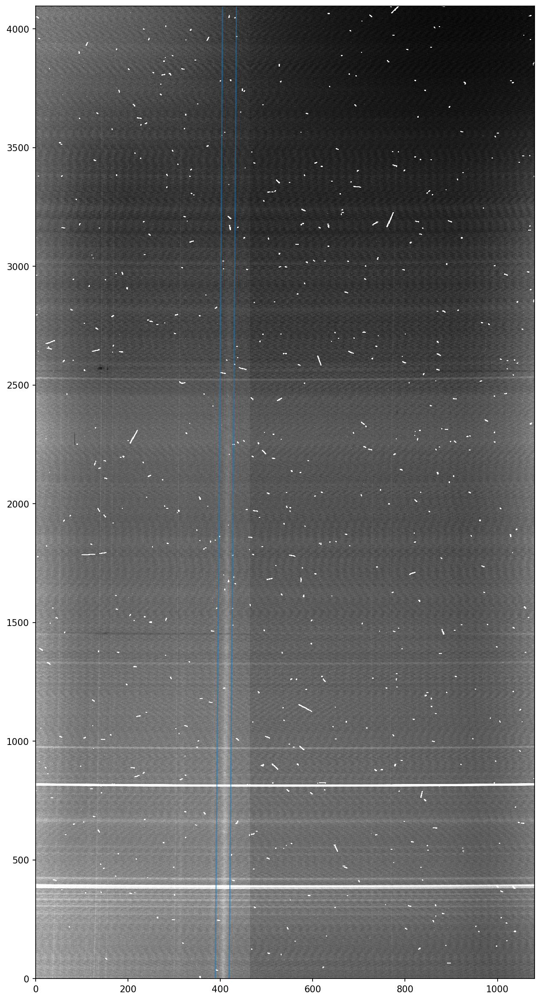

In [191]:
plot_image_trace(qso1_blue_2d[0], std_blue1_trace)#+5)

In [196]:
qso1_blue_1d = {}
qso1_blue_sky = {}
for i in range(2):
    qso1_blue_1d[i], qso1_blue_sky[i] = kosmos.BoxcarExtract(qso1_blue_2d[i], std_blue1_trace, 
                                                   display=True, ax=ax, 
                                                  Saxis=1,apwidth=15)

/Users/chris/GradResearch/kosmos/kosmos/apextract.py:335: RuntimeWarning: invalid value encountered in sqrt
  fluxerr[i] = np.sqrt(np.nansum((onedspec[i]-skysubflux[i])) +
/Users/chris/GradResearch/kosmos/kosmos/apextract.py:335: RuntimeWarning: invalid value encountered in sqrt
  fluxerr[i] = np.sqrt(np.nansum((onedspec[i]-skysubflux[i])) +


zscale vmin,vmax:0.02082085696050927,0.364234279964856


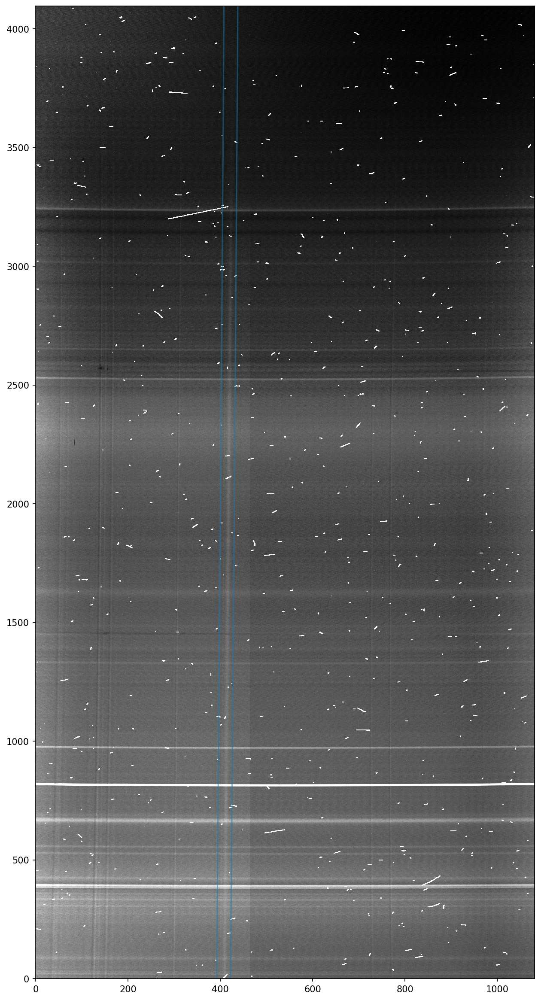

In [195]:
plot_image_trace(qso2_blue_2d[0], std_blue1_trace+3)#+5)

In [197]:
qso2_blue_1d = {}
qso2_blue_sky = {}
for i in range(2):
    qso2_blue_1d[i], qso2_blue_sky[i] = kosmos.BoxcarExtract(qso2_blue_2d[i], std_blue1_trace+3, 
                                                   display=True, ax=ax, Saxis=1,apwidth=15)

/Users/chris/GradResearch/kosmos/kosmos/apextract.py:335: RuntimeWarning: invalid value encountered in sqrt
  fluxerr[i] = np.sqrt(np.nansum((onedspec[i]-skysubflux[i])) +
/Users/chris/GradResearch/kosmos/kosmos/apextract.py:335: RuntimeWarning: invalid value encountered in sqrt
  fluxerr[i] = np.sqrt(np.nansum((onedspec[i]-skysubflux[i])) +


# Extract arc lamps

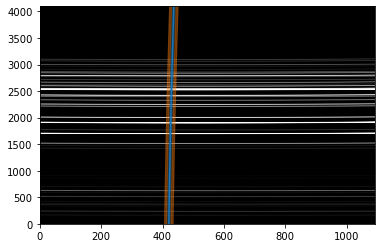

/Users/chris/GradResearch/kosmos/kosmos/apextract.py:335: RuntimeWarning: invalid value encountered in sqrt
  fluxerr[i] = np.sqrt(np.nansum((onedspec[i]-skysubflux[i])) +
/Users/chris/GradResearch/kosmos/kosmos/apextract.py:335: RuntimeWarning: invalid value encountered in sqrt
  fluxerr[i] = np.sqrt(np.nansum((onedspec[i]-skysubflux[i])) +


In [198]:
fig, ax = plt.subplots(1,1)

# NB   I use the same tool as is usually used to extract the object
# object_spec_1d , sky_spec_1d,
# but for arc lamps there is no sky, so I just leave "_" since I won't
# use it for anything.

#argon: 1 exp
red_neon_1d , _  = kosmos.BoxcarExtract(red_neon_2d[0], std_red2_trace, display=True, 
                                                 ax=ax, Saxis=1,
                                                 apwidth=3, skysep=5, skywidth=5)
    
red_krypton_1d , _  = kosmos.BoxcarExtract(red_krypton_2d[0], std_red2_trace, display=True, 
                                                 ax=ax, Saxis=1,
                                                 apwidth=3, skysep=5, skywidth=5)

blue_neon_1d , _  = kosmos.BoxcarExtract(blue_neon_2d[0], std_blue2_trace, display=True, 
                                                 ax=ax, Saxis=1,
                                                 apwidth=3, skysep=5, skywidth=5)
blue_krypton_1d , _  = kosmos.BoxcarExtract(blue_krypton_2d[0], std_blue2_trace, display=True, 
                                                 ax=ax, Saxis=1,
                                                 apwidth=3, skysep=5, skywidth=5)



# Wavelength Calibration

Red: anchor from red low Neon:

Importing the dtw module. When using in academic works please cite:
  T. Giorgino. Computing and Visualizing Dynamic Time Warping Alignments in R: The dtw Package.
  J. Stat. Soft., doi:10.18637/jss.v031.i07.



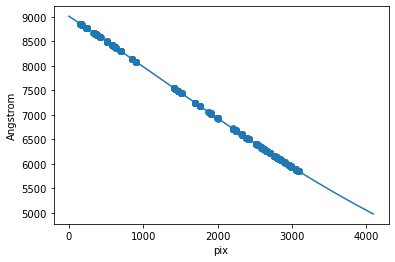

In [199]:
from specutils import Spectrum1D
red_ref = Table.read('red_low_Neon_1d_wave.txt', format='ascii',)
red_ref_1d = Spectrum1D(spectral_axis=red_ref['wave'].data * u.angstrom,
                        flux=red_ref['flux'].data * u.adu)



xrl, wrl = kosmos.identify_dtw(red_neon_1d, red_ref_1d , upsample=False, 
                            open_begin=True, open_end=True, step_pattern='asymmetric',
                            display=True, peak_spline=True, pthreshold=0.9)



In [200]:
fit_wavelength_args={'mode':'interp', 'deg':1}
red_neon_1d_wave = kosmos.fit_wavelength(red_neon_1d, 
                                         xrl, wrl, **fit_wavelength_args
                                        )

red_krypton_1d_wave = kosmos.fit_wavelength(red_krypton_1d, 
                                         xrl, wrl, **fit_wavelength_args
                                        )

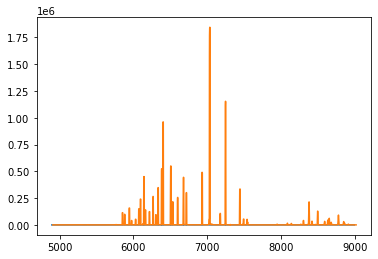

In [201]:
plt.plot(red_ref_1d.spectral_axis, red_ref_1d.flux)
plt.plot(red_neon_1d_wave.spectral_axis, red_neon_1d_wave.flux)

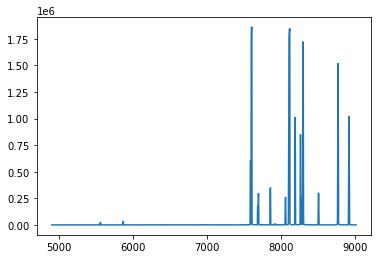

In [202]:
plt.plot(red_krypton_1d_wave.spectral_axis, red_krypton_1d_wave.flux)


In [210]:

# store the wavelength-calibrated arc lamp spectrum 
t = Table(data=[np.array(red_neon_1d_wave.wavelength), np.array(red_neon_1d_wave.flux)],
          names=['wave','flux'])
t.write('red_low_neon_1d_wave_230427.txt', 
         format='ascii', overwrite=True)

In [209]:

# store the wavelength-calibrated arc lamp spectrum 
t = Table(data=[np.array(red_krypton_1d_wave.wavelength), np.array(red_krypton_1d_wave.flux)],
          names=['wave','flux'])
t.write('red_low_krypton_1d_wave_230427.txt', 
         format='ascii', overwrite=True)

Blue: blue low neon should be fine : 

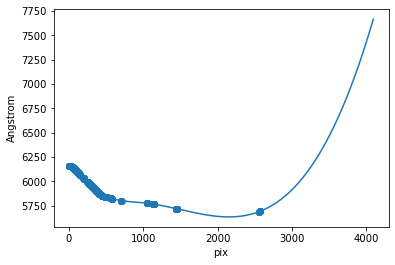

In [206]:
blue_ref = Table.read('blue_low_neon_1d_wave.txt', format='ascii',)
blue_ref_1d = Spectrum1D(spectral_axis=blue_ref['wave'].data * u.angstrom,
                        flux=blue_ref['flux'].data * u.adu)

xbl, wbl = kosmos.identify_dtw(blue_neon_1d, blue_ref_1d , upsample=False, 
                            open_begin=True, open_end=True, step_pattern='asymmetric',
                            display=True, peak_spline=True, pthreshold=0.9)

??? That looks very bad. Try krypton

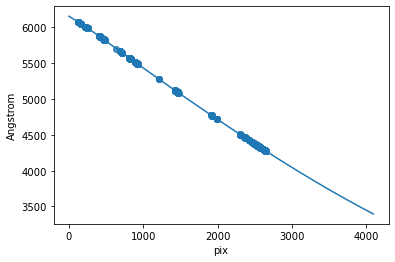

In [207]:
blue_ref = Table.read('blue_low_krypton_1d_wave_230319.txt', format='ascii',)
blue_ref_1d = Spectrum1D(spectral_axis=blue_ref['wave'].data * u.angstrom,
                        flux=blue_ref['flux'].data * u.adu)

xbl, wbl = kosmos.identify_dtw(blue_krypton_1d, blue_ref_1d , upsample=False, 
                            open_begin=True, open_end=True, step_pattern='asymmetric',
                            display=True, peak_spline=True, pthreshold=0.9)

That's what it's supposed to be! So now store the wavelength-calibrated arc lamps:

In [211]:
fit_wavelength_args={'mode':'interp', 'deg':1}
blue_neon_1d_wave = kosmos.fit_wavelength(blue_neon_1d, 
                                         xbl, wbl, **fit_wavelength_args
                                        )

blue_krypton_1d_wave = kosmos.fit_wavelength(blue_krypton_1d, 
                                         xbl, wbl, **fit_wavelength_args
                                        )

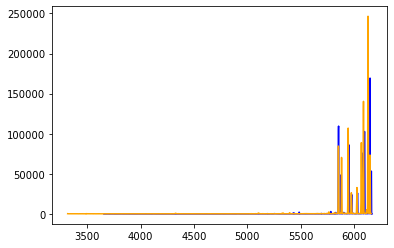

In [225]:
blue_ref = Table.read('blue_low_neon_1d_wave.txt', format='ascii',)
plt.plot(blue_ref['wave'], blue_ref['flux']*50, c='blue')
plt.plot(blue_neon_1d_wave.spectral_axis, blue_neon_1d_wave.flux, c='orange')

In [229]:
# store the wavelength-calibrated arc lamp spectrum 
t = Table(data=[np.array(blue_neon_1d_wave.wavelength), np.array(blue_neon_1d_wave.flux)],
          names=['wave','flux'])
t.write('blue_low_neon_int_230427.txt', 
         format='ascii', overwrite=True)

ok, it's the same lines, but flux levels were so different that it didn't work for that reason... Perhaps the default exposure time for internal Neon should be shorter...

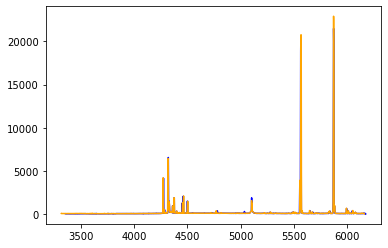

In [228]:
blue_ref = Table.read('blue_low_krypton_1d_wave_230319.txt', format='ascii',)
plt.plot(blue_ref['wave'], blue_ref['flux'], c='blue')
plt.plot(blue_krypton_1d_wave.spectral_axis, blue_krypton_1d_wave.flux,c='orange' )

That's identical - this is because Krypton from 3/19 was internal too! So it matters whether it's internal or external ... 

In [230]:
# store the wavelength-calibrated arc lamp spectrum 
t = Table(data=[np.array(blue_krypton_1d_wave.wavelength), np.array(blue_krypton_1d_wave.flux)],
          names=['wave','flux'])
t.write('blue_low_krypton_int_230427.txt', 
         format='ascii', overwrite=True)

# Apply wavelength solution 

In [231]:
import specutils
# signature of calibrate_wavelengths is (xpts, wpts, obj_spectrum, sky_spectrum...)

def apply_wavelength_solution(obj_spectrum, xpts=None, wpts=None, 
                              sky_spectrum=None,  
                              fit_wavelength_args={'mode':'interp',
                              'deg':1}):
    
    ''' This is needed to apply a wavelength solution (xpts, wpts) mapping,
    i.e. what wavelength  each x-pixel position along the spectral axis 
    corresponds to. These points are used to fit a simple eg. linear
    function that maps x-position to wavelength. 
    
    obj_spectrum: specutils.spectra.spectrum1d.Spectrum1D, 
        a 1D spectrum (i.e. after extraction of the spectrum 
        along  a trace from an original FITS image, which 
        is a 2D spectrum). 
        If the  obj_spectrum corresponds to a sky observation, 
        it will contain sky lines contamination (eg. science object,
        standard star). In that case, sky_spectrum should also be 
        provided to create a sky-subtracted spectrum.
        However, uf obj_spectrum corresponds to a calibration,
        eg. external or internal calibration arc lamps, 
        then there is no need to subtract sky background emission
        (since there isn't any). 
    xpts:  numpy.ndarray  of x-positions along spectral axis 
    wpts:  numpy.ndarray of wavelength (in Angstroms) along spectral axis 
    sky_spectrum: specutils.spectra.spectrum1d.Spectrum1D (optional)
       a 1D spectrum (as above), usually from running 
       obj_spectrum, sky_spectrum = kosmos.BoxcarExtract(obj_2D_spectrum, 
                                       obj_trace, **kwargs)
    mode: str, mode used by kosmos.fit_wavelength() ('interp' or 'gp') 
    deg : int,  degree of polynomial (default is 1) options 
         passed to   kosmos.fit_wavelength()             
    
    '''
    # xpts = xpxl_int_arc_red
    # wpts = wpts_int_arc_red
    # obj_spectrum = red_neon_1d
    # sky_spectrum = red_neon_sky

    #Create sky subtracted spectrum
    if sky_spectrum is not None:
        obj_flux = obj_spectrum.flux-sky_spectrum.flux
    else:
        obj_flux = obj_spectrum.flux
    sky_sub_obj_spectrum = specutils.Spectrum1D(flux=obj_flux, 
                                                spectral_axis=obj_spectrum.spectral_axis, 
                                    uncertainty=obj_spectrum.uncertainty)

    #Apply the wavelength solution to the sky subtracted spectrum
    obj_wave = kosmos.fit_wavelength(sky_sub_obj_spectrum, 
                                            xpts, wpts, **fit_wavelength_args)
    #mode='interp', deg=deg)
    return obj_wave

In [233]:
std2_red_1d

<Spectrum1D(flux=<Quantity [ 9795.49673108, 17826.53529656, 16024.45765316, ...,
           45571.58083996, 45380.21870571, 45012.92775708] adu / s>, spectral_axis=<SpectralAxis [0.000e+00, 1.000e+00, 2.000e+00, ..., 4.093e+03, 4.094e+03, 4.095e+03] pix>, uncertainty=StdDevUncertainty([113.59045087, 154.85008517, 155.77188671, ...,
                   221.01970368, 246.06506581, 243.03376757]))>

Text(0.5, 1.0, 'Wavelength Calibrated Spectrum HR5501 (Red+Blue)')

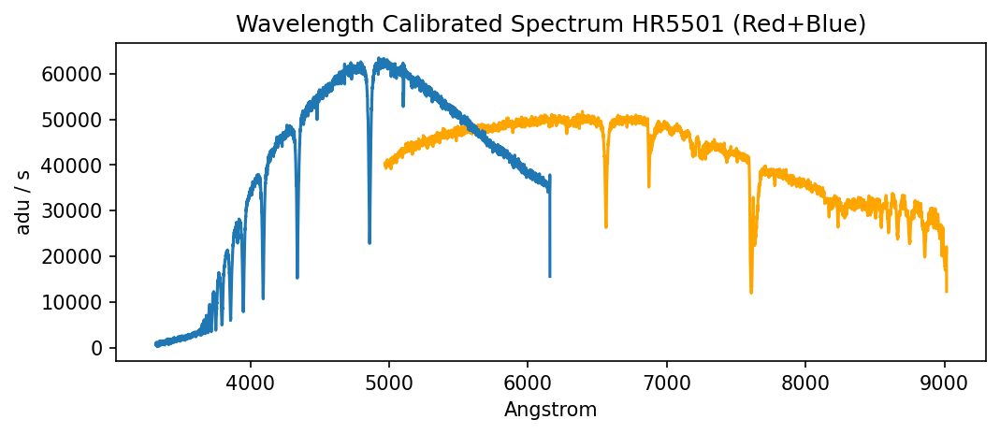

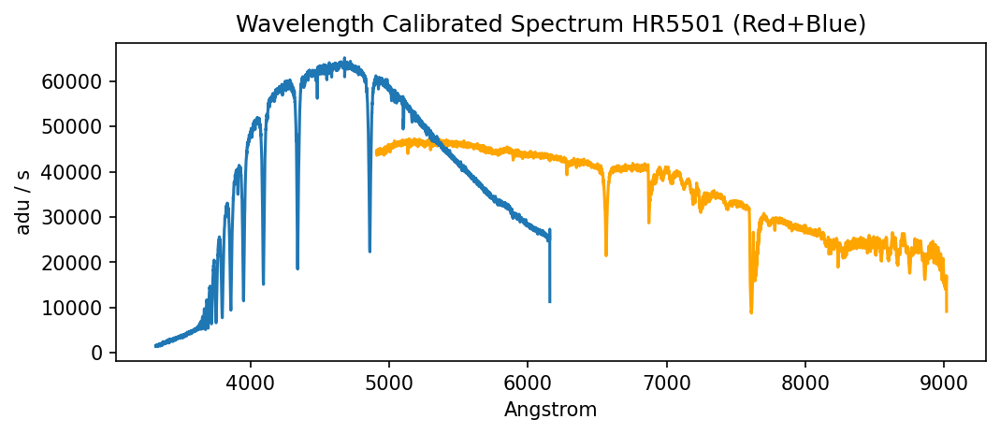

In [238]:


#std_red1_1d_wave = {} # GD50   1 exp 
#std_red2_1d_wave = {} # Feige34 1 exp 
#std_blue2_1d_wave = {} # 1 exp 

# red low 
std1_red_1d_wave,_ = apply_wavelength_solution(std1_red_1d,  
                                xrl, wrl,
                                std1_red_sky,  
                                fit_wavelength_args = {'mode':'gp', 
                                'display':False, 
                                'returnvar':True, 
                                'GPRscale':101}
                                )

fit_wavelength_args={'mode':'interp', 'deg':1}
std2_red_1d_wave = apply_wavelength_solution(std2_red_1d,  
                                xrl, wrl,
                                std2_red_sky,  
                                fit_wavelength_args )

# blue low 
std1_blue_1d_wave  = apply_wavelength_solution(std1_blue_1d,  
                                xbl, wbl,
                                std1_blue_sky,  
                                fit_wavelength_args
                                )
std2_blue_1d_wave  = apply_wavelength_solution(std2_blue_1d,  
                                xbl, wbl,
                                std2_blue_sky,  
                                fit_wavelength_args
                                )


%matplotlib inline
fig,ax = plt.subplots(1,1, figsize=(8,3), facecolor='w',  dpi=150)
ax.plot(std1_red_1d_wave.spectral_axis, 
        std1_red_1d_wave.flux, c='orange')
ax.plot(std1_blue_1d_wave.spectral_axis, 
       std1_blue_1d_wave.flux)
ax.set_xlabel(std1_red_1d_wave.spectral_axis.unit)
ax.set_ylabel(std1_red_1d_wave.flux.unit)
ax.set_title('Wavelength Calibrated Spectrum HR5501 (Red+Blue)')

fig,ax = plt.subplots(1,1, figsize=(8,3), facecolor='w',  dpi=150)
ax.plot(std2_red_1d_wave.spectral_axis, 
        std2_red_1d_wave.flux, c='orange')
ax.plot(std2_blue_1d_wave.spectral_axis, 
       std2_blue_1d_wave.flux)
ax.set_xlabel(std2_blue_1d_wave.spectral_axis.unit)
ax.set_ylabel(std2_blue_1d_wave.flux.unit)
ax.set_title('Wavelength Calibrated Spectrum HR5501 (Red+Blue)')


The two look ~pretty similar... 

Text(0.5, 1.0, 'Wavelength Calibrated Spectrum QSO J153355 (Red)')

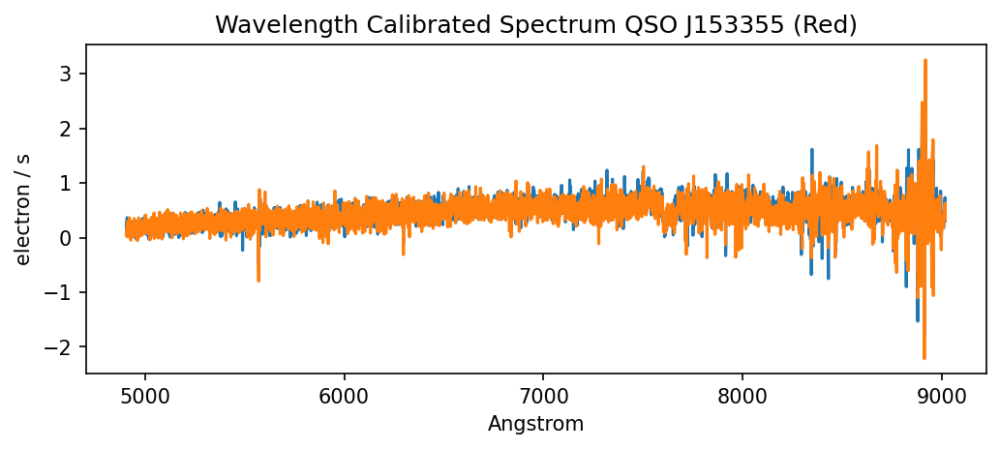

In [246]:
qso1_red_1d_wave = {} # SDSSJ153355.99+011029.7
qso1_blue_1d_wave = {} 

qso2_red_1d_wave = {} #@ SDSSJ172322.30+550413.8 
qso2_blue_1d_wave = {} 

for i in range(2):
    # two red exposures 
    qso1_red_1d_wave[i] = apply_wavelength_solution(qso1_red_1d[i],  
                                xrl, wrl,
                                qso1_red_sky[i],  
                                fit_wavelength_args
                                )
    qso1_blue_1d_wave[i] = apply_wavelength_solution(qso1_blue_1d[i],  
                                xbl, wbl,
                                qso1_blue_sky[i],  
                                fit_wavelength_args
                                )
    
    qso2_blue_1d_wave[i] = apply_wavelength_solution(qso2_blue_1d[i],  
                                xbl, wbl,
                                qso2_blue_sky[i],  
                                fit_wavelength_args
                                )
# one red exposure
qso2_red_1d_wave[0] = apply_wavelength_solution(qso2_red_1d[0],  
                                xrl, wrl,
                                qso2_red_sky[0],  
                                fit_wavelength_args
                                )


%matplotlib inline
fig,ax = plt.subplots(1,1, figsize=(8,3), facecolor='w',  dpi=150)
for i in range(2):
    ax.plot(qso1_red_1d_wave[i].spectral_axis, 
        qso1_red_1d_wave[i].flux, )#c='orange')
ax.set_xlabel(qso1_red_1d_wave[0].spectral_axis.unit)
ax.set_ylabel(qso1_red_1d_wave[0].flux.unit)
ax.set_title('Wavelength Calibrated Spectrum QSO J153355 (Red)')


Text(0.5, 1.0, 'Wavelength Calibrated Spectrum QSO J172322 (Red)')

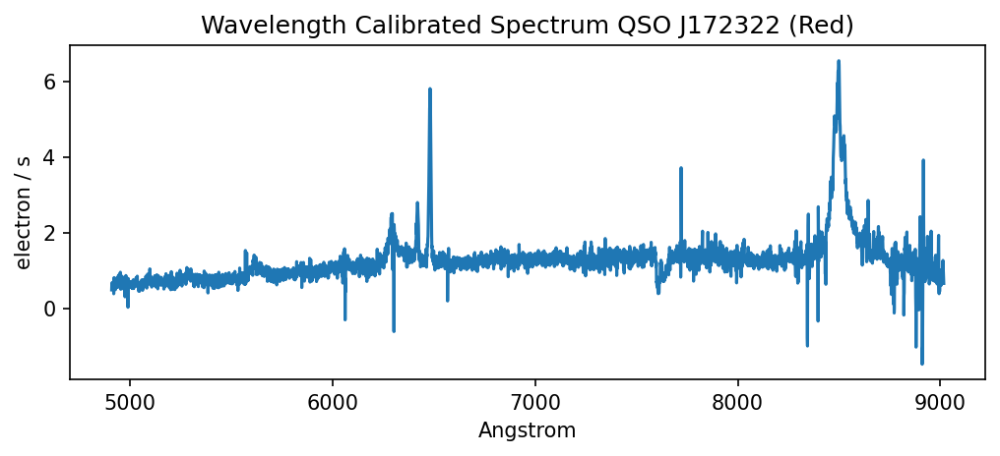

In [247]:
fig,ax = plt.subplots(1,1, figsize=(8,3), facecolor='w',  dpi=150)
for i in range(1):
    ax.plot(qso2_red_1d_wave[i].spectral_axis, 
        qso2_red_1d_wave[i].flux, )#c='orange')
ax.set_xlabel(qso1_red_1d_wave[0].spectral_axis.unit)
ax.set_ylabel(qso1_red_1d_wave[0].flux.unit)
ax.set_title('Wavelength Calibrated Spectrum QSO J172322 (Red)')

Text(0.5, 1.0, 'Wavelength Calibrated Spectrum QSO J153355 (blue)')

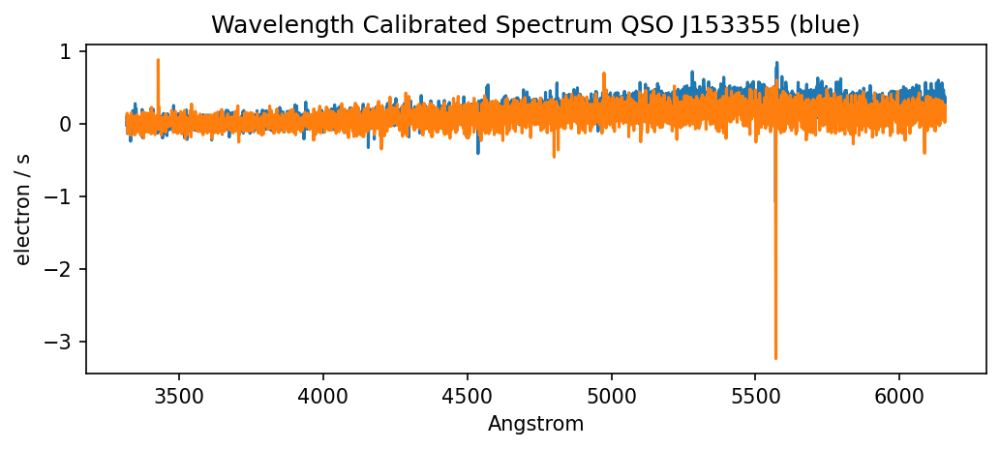

In [248]:
fig,ax = plt.subplots(1,1, figsize=(8,3), facecolor='w',  dpi=150)
for i in range(2):
    ax.plot(qso1_blue_1d_wave[i].spectral_axis, 
        qso1_blue_1d_wave[i].flux, )#c='orange')
ax.set_xlabel(qso1_blue_1d_wave[0].spectral_axis.unit)
ax.set_ylabel(qso1_blue_1d_wave[0].flux.unit)
ax.set_title('Wavelength Calibrated Spectrum QSO J153355 (blue)')


Text(0.5, 1.0, 'Wavelength Calibrated Spectrum QSO J172322 (blue)')

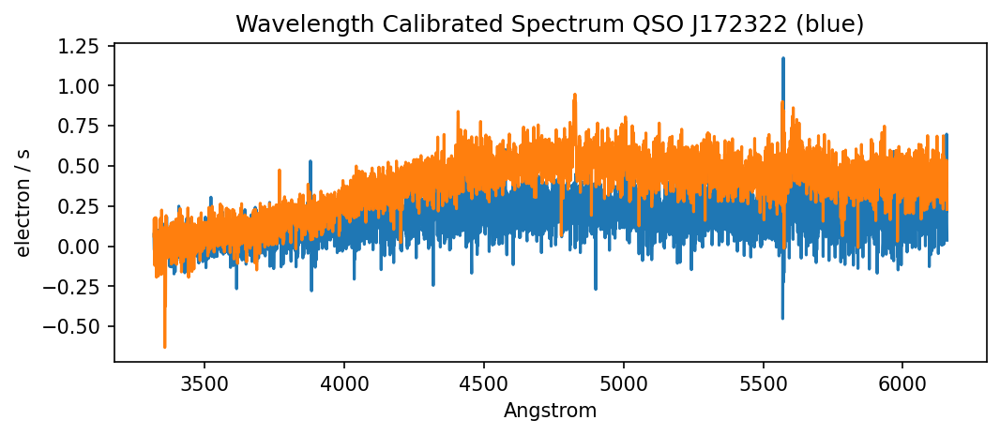

In [249]:
fig,ax = plt.subplots(1,1, figsize=(8,3), facecolor='w',  dpi=150)
for i in range(2):
    ax.plot(qso2_blue_1d_wave[i].spectral_axis, 
        qso2_blue_1d_wave[i].flux, )#c='orange')
ax.set_xlabel(qso1_blue_1d_wave[0].spectral_axis.unit)
ax.set_ylabel(qso1_blue_1d_wave[0].flux.unit)
ax.set_title('Wavelength Calibrated Spectrum QSO J172322 (blue)')


# Airmass Correction

In [253]:
Xfile = kosmos.obs_extinction('apoextinct.dat')
# only red has two exps,  blue has one ... 
qso1_red_1d_amcorr = {}
qso1_blue_1d_amcorr = {}

qso2_red_1d_amcorr = {}
qso2_blue_1d_amcorr = {}


std1_red_1d_amcorr = kosmos.airmass_cor(std1_red_1d_wave, 
                                        std_red1_2d.header['AIRMASS'],
                                        Xfile)
std2_red_1d_amcorr = kosmos.airmass_cor(std2_red_1d_wave, 
                                      std_red2_2d.header['AIRMASS'],
                                      Xfile)
std1_blue_1d_amcorr = kosmos.airmass_cor(std1_blue_1d_wave, 
                                      std_blue1_2d.header['AIRMASS'],
                                      Xfile)
std2_blue_1d_amcorr = kosmos.airmass_cor(std2_blue_1d_wave, 
                                      std_blue2_2d.header['AIRMASS'],
                                      Xfile)

for i in range(2):
    qso1_red_1d_amcorr[i] = kosmos.airmass_cor(qso1_red_1d_wave[i], 
                                          qso1_red_2d[i].header['AIRMASS'],
                                          Xfile)
    qso1_blue_1d_amcorr[i] = kosmos.airmass_cor(qso1_blue_1d_wave[i], 
                                          qso1_blue_2d[i].header['AIRMASS'],
                                          Xfile)
    qso2_blue_1d_amcorr[i] = kosmos.airmass_cor(qso2_blue_1d_wave[i], 
                                          qso2_blue_2d[i].header['AIRMASS'],
                                          Xfile)

qso2_red_1d_amcorr[0] = kosmos.airmass_cor(qso2_red_1d_wave[0], 
                                          qso2_red_2d[0].header['AIRMASS'],
                                          Xfile)
    

In [252]:
qso1

{}

# Flux Calibration

In [254]:
kosmos_path = os.path.split(kosmos.__file__)[:-1][0]
path_to_stds = os.path.join(kosmos_path, 'resources','onedstds')
dirs = next(os.walk(path_to_stds))[1]
for d in dirs:
    stars = os.listdir(os.path.join(path_to_stds, d))
    for star in stars :
        if ('hr5501' in star) :
            print(d, star)
       

spec16cal hr5501red.dat
spec16cal hr5501.dat
spec16cal hr5501blue.dat


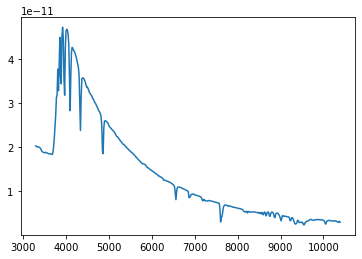

In [255]:
std = kosmos.onedstd('spec16cal/hr5501.dat')
plt.plot(std['wave'], std['flux'])

Text(0, 0.5, 'sensfunc')

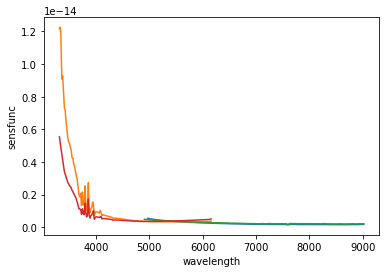

In [257]:
sens_func_red = kosmos.standard_sensfunc(std1_red_1d_amcorr, 
                                             std, mode='linear')
sens_func_blue = kosmos.standard_sensfunc(std1_blue_1d_amcorr, 
                                              std, mode='linear')
sens_func_red2 = kosmos.standard_sensfunc(std2_red_1d_amcorr, 
                                             std, mode='linear')
sens_func_blue2= kosmos.standard_sensfunc(std2_blue_1d_amcorr, 
                                              std, mode='linear')


%matplotlib inline

plt.plot(sens_func_red.spectral_axis, sens_func_red.flux)
plt.plot(sens_func_blue.spectral_axis, sens_func_blue.flux)

plt.plot(sens_func_red2.spectral_axis, sens_func_red2.flux)
plt.plot(sens_func_blue2.spectral_axis, sens_func_blue2.flux)

plt.xlabel('wavelength')
plt.ylabel('sensfunc')

In theory the first one should be applied to the first star and first quasar, and the second one to second star and second quasar. Try doing that:

In [366]:
std1_red_1d_fluxcal = kosmos.apply_sensfunc(std1_red_1d_amcorr, sens_func_red, )
std1_blue_1d_fluxcal = kosmos.apply_sensfunc(std1_blue_1d_amcorr, sens_func_blue, )

std2_red_1d_fluxcal = kosmos.apply_sensfunc(std2_red_1d_amcorr, sens_func_red2, )
std2_blue_1d_fluxcal = kosmos.apply_sensfunc(std2_blue_1d_amcorr, sens_func_blue2, )


qso1_red_1d_fluxcal = {}
qso1_blue_1d_fluxcal = {}

qso2_red_1d_fluxcal = {}
qso2_blue_1d_fluxcal = {}

for i in range(2):
    qso1_red_1d_fluxcal[i] = kosmos.apply_sensfunc(qso1_red_1d_amcorr[i], sens_func_red, )
    qso1_blue_1d_fluxcal[i] = kosmos.apply_sensfunc(qso1_blue_1d_amcorr[i], sens_func_blue, )
    qso2_blue_1d_fluxcal[i] = kosmos.apply_sensfunc(qso2_blue_1d_amcorr[i], sens_func_blue)
qso2_red_1d_fluxcal[0] = kosmos.apply_sensfunc(qso2_red_1d_amcorr[0], sens_func_red)

Text(0.5, 1.0, 'Flux Calibrated Spectrum   red')

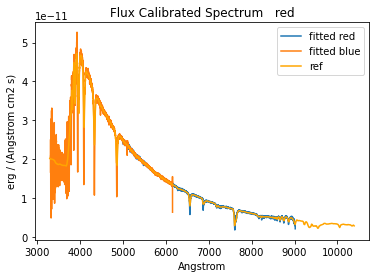

In [272]:
fig, ax = plt.subplots(1,1)

ax.plot(std1_red_1d_fluxcal.spectral_axis.value, std1_red_1d_fluxcal.flux.value,
       label='fitted red ')
ax.plot(std1_blue_1d_fluxcal.spectral_axis.value, std1_blue_1d_fluxcal.flux.value,
       label='fitted blue')

# plotting the reference spectrum... 
ax.plot(std['wave'], std['flux'], c='orange', label='ref')
ax.legend()
ax.set_xlabel(std1_red_1d_fluxcal.spectral_axis.unit)
ax.set_ylabel(std1_red_1d_fluxcal.flux.unit)
ax.set_title('Flux Calibrated Spectrum   red')  

Text(0.5, 1.0, 'Flux Calibrated Spectrum   red')

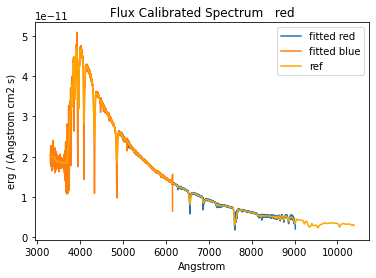

In [273]:
fig, ax = plt.subplots(1,1)

ax.plot(std2_red_1d_fluxcal.spectral_axis.value, std2_red_1d_fluxcal.flux.value,
       label='fitted red ')
ax.plot(std2_blue_1d_fluxcal.spectral_axis.value, std2_blue_1d_fluxcal.flux.value,
       label='fitted blue')

# plotting the reference spectrum... 
ax.plot(std['wave'], std['flux'], c='orange', label='ref')
ax.legend()
ax.set_xlabel(std1_red_1d_fluxcal.spectral_axis.unit)
ax.set_ylabel(std1_red_1d_fluxcal.flux.unit)
ax.set_title('Flux Calibrated Spectrum   red')  

Do the calibrated flux levels agree?

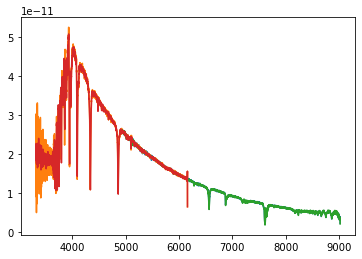

In [274]:

fig, ax = plt.subplots(1,1)
ax.plot(std1_red_1d_fluxcal.spectral_axis.value, std1_red_1d_fluxcal.flux.value,
       label='red exp1')
ax.plot(std1_blue_1d_fluxcal.spectral_axis.value, std1_blue_1d_fluxcal.flux.value,
       label='blue exp1')

ax.plot(std2_red_1d_fluxcal.spectral_axis.value, std2_red_1d_fluxcal.flux.value,
       label='red exp2')
ax.plot(std2_blue_1d_fluxcal.spectral_axis.value, std2_blue_1d_fluxcal.flux.value,
       label='blue exp2')

yes, they do! so now how do the QSO look like:

(0.0, 1e-15)

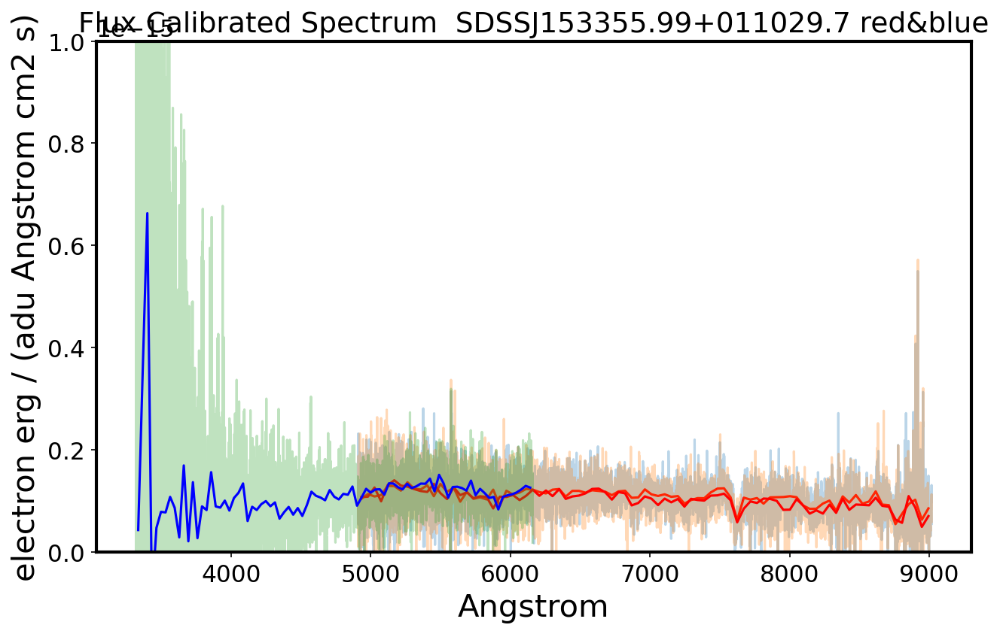

In [382]:
from scipy.stats import binned_statistic
fig, ax = plt.subplots(1,1, figsize=(10,6), dpi=150, facecolor='w')
for i in range(2):
    x = qso1_red_1d_fluxcal[i].spectral_axis.value
    y = qso1_red_1d_fluxcal[i].flux.value
    statistic, bin_edges, binnumber = binned_statistic(x,y, statistic='median', bins=87)
    bin_centers  =  (bin_edges[1:] + bin_edges[:-1] ) /2.
    ax.plot(x,y, alpha=0.3)
    ax.plot(bin_centers, statistic, c='red')

i=0
x = qso1_blue_1d_fluxcal[i].spectral_axis.value
y = qso1_blue_1d_fluxcal[i].flux.value

statistic, bin_edges, binnumber = binned_statistic(x,y, statistic='median', bins=87)
bin_centers  =  (bin_edges[1:] + bin_edges[:-1] ) /2.
ax.plot(x,y, alpha=0.3)
ax.plot(bin_centers, statistic, c='blue')

ax.set_xlabel(qso1_red_1d_fluxcal[0].spectral_axis.unit)
ax.set_ylabel(qso1_red_1d_fluxcal[0].flux.unit)
ax.set_title('Flux Calibrated Spectrum  SDSSJ153355.99+011029.7 red&blue')  
ax.set_ylim(0,0.1e-14)

In [363]:
qso2_blue_1d_fluxcal[0].flux.value

array([ 2.08765745e-17,  8.15973849e-17,  3.87811470e-16, ...,
       -2.62633824e-16,  4.85487474e-16,  8.21458381e-16])

In [364]:
qso2_blue_1d_fluxcal[1].flux.value

array([1.28253592e-16, 2.82493325e-16, 2.97090729e-16, ...,
       1.81340047e-15, 1.87379450e-15, 6.95321107e-16])

(0.0, 1e-15)

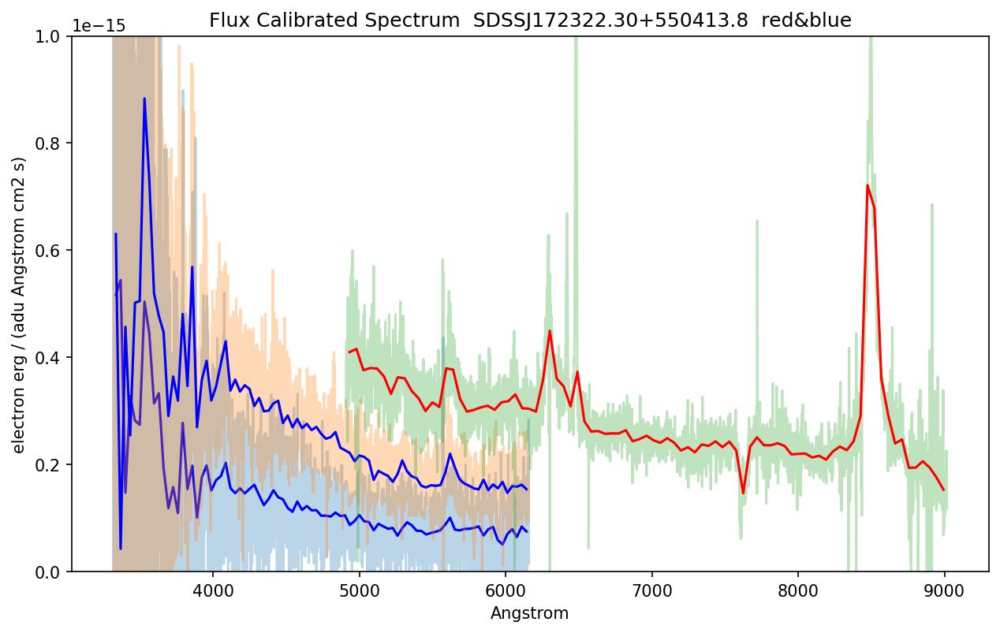

In [367]:
from scipy.stats import binned_statistic
fig, ax = plt.subplots(1,1, figsize=(10,6), dpi=150, facecolor='w')

for i in range(2):
    x = qso2_blue_1d_fluxcal[i].spectral_axis.value
    y = qso2_blue_1d_fluxcal[i].flux.value
    statistic, bin_edges, binnumber = binned_statistic(x,y, statistic='median', bins=87)
    bin_centers  =  (bin_edges[1:] + bin_edges[:-1] ) /2.
    ax.plot(x,y, alpha=0.3)
    ax.plot(bin_centers, statistic, c='blue', label='APO blue')
    
x = qso2_red_1d_fluxcal[0].spectral_axis.value
y = qso2_red_1d_fluxcal[0].flux.value
statistic, bin_edges, binnumber = binned_statistic(x,y, statistic='median', bins=87)
bin_centers  =  (bin_edges[1:] + bin_edges[:-1] ) /2.
ax.plot(x,y, alpha=0.3)
ax.plot(bin_centers, statistic, c='red', label='APO red')
ax.set_xlabel(qso1_red_1d_fluxcal[0].spectral_axis.unit)
ax.set_ylabel(qso1_red_1d_fluxcal[0].flux.unit)
ax.set_title('Flux Calibrated Spectrum  SDSSJ172322.30+550413.8  red&blue')  
ax.set_ylim(0,0.1e-14)

# Compare to stored SDSS spectra : 153355

In [283]:
names[0]

'172322.31+550413.8'

In [301]:
sp[0][0].header['NAME']

'0367-51990-01'

In [300]:
sp[0][0].header['MJD']

51997

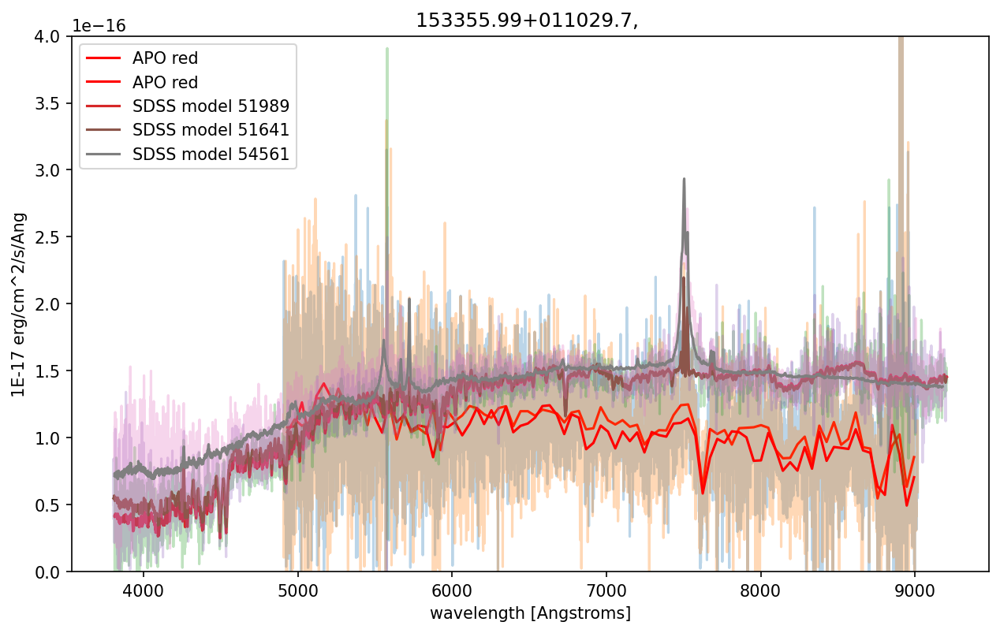

In [355]:
sp = sdss_spectra['153355.99+011029.7']

from scipy.stats import binned_statistic
fig, ax = plt.subplots(1,1, figsize=(10,6), dpi=150, facecolor='w')
for i in range(2):
    x = qso1_red_1d_fluxcal[i].spectral_axis.value
    y = qso1_red_1d_fluxcal[i].flux.value
    statistic, bin_edges, binnumber = binned_statistic(x,y, statistic='median', bins=87)
    bin_centers  =  (bin_edges[1:] + bin_edges[:-1] ) /2.
    ax.plot(x,y, alpha=0.3)
    ax.plot(bin_centers, statistic, c='red', label='APO red')
    
#     x = qso1_blue_1d_fluxcal[i].spectral_axis.value
#     y = qso1_blue_1d_fluxcal[i].flux.value
    
#     statistic, bin_edges, binnumber = binned_statistic(x,y, statistic='median', bins=87)
#     bin_centers  =  (bin_edges[1:] + bin_edges[:-1] ) /2.
#     ax.plot(x,y, alpha=0.3)
#     ax.plot(bin_centers, statistic, c='blue')

ax.set_xlabel(qso1_red_1d_fluxcal[0].spectral_axis.unit)
ax.set_ylabel(qso1_red_1d_fluxcal[0].flux.unit)
ax.set_title('Flux Calibrated Spectrum  SDSSJ153355.99+011029.7 red&blue')  
ax.set_ylim(0,0.4e-15)

for i in range(3):
    mjd = sp[i][0].header['MJD']
    
    spec = sp[i][1].data
    
    ax.plot(np.power(10,spec['loglam']), spec['flux']*1e-17, alpha=0.3)
    ax.plot(np.power(10,spec['loglam']), spec['model']*1e-17, label=f'SDSS model {mjd}')
    
ax.set_title(f'{name}, ')#mjd={mjd}',)
ax.set_xlabel('wavelength [Angstroms]')
ax.set_ylabel( sp[i][0].header['BUNIT'])
ax.legend()

Use only the blue filter that was taken when the clouds were  not there... 

Returning only the median per bin as there is only one exposure
Returning only the median per bin as there is only one exposure


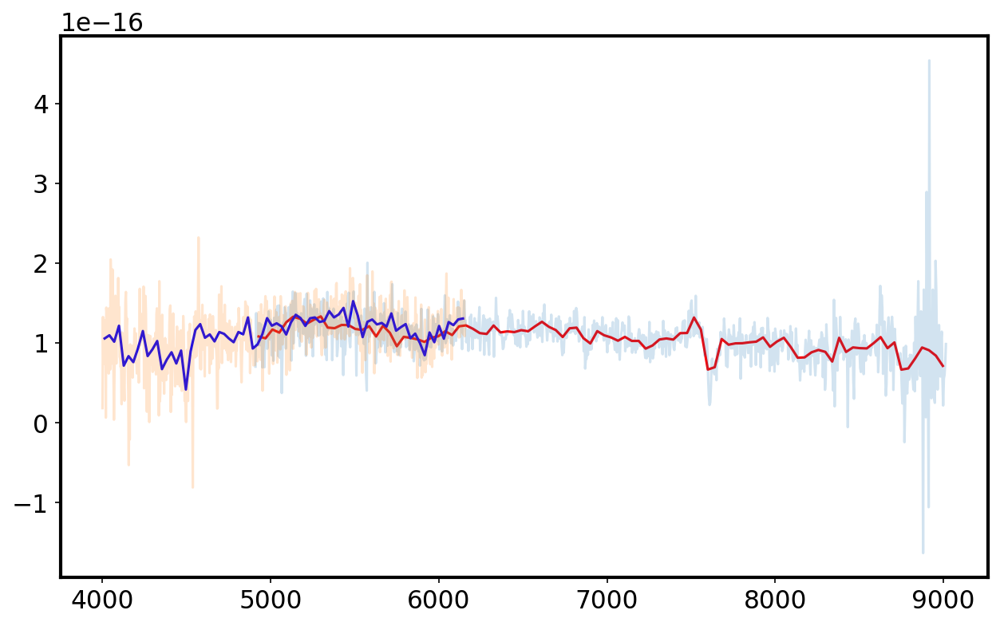

In [383]:
import functions as func
red_spectra = {}
for i in range(2):
    red_spectra[i] = {}
    red_spectra[i]['wavelength'] = qso1_red_1d_fluxcal[i].spectral_axis.value
    red_spectra[i]['flux'] = qso1_red_1d_fluxcal[i].flux.value
result_red = func.median_n_exposures(red_spectra, Nbins=100)
result_red_bkgnd = func.median_n_exposures(red_spectra, Nbins=1000)

blue_spectra = {}
for i in range(1): # only take the first exposure ... 
    blue_spectra[i] = {}
    blue_spectra[i]['wavelength'] = qso1_blue_1d_fluxcal[i].spectral_axis.value
    blue_spectra[i]['flux'] = qso1_blue_1d_fluxcal[i].flux.value
result_blue = func.median_n_exposures(blue_spectra, Nbins=100)
result_blue_bkgnd = func.median_n_exposures(blue_spectra, Nbins=1000)


fig, ax = plt.subplots(1,1, figsize=(10,6), dpi=150, facecolor='w')
ax.plot(result_red['bins'], result_red['flux_med_per_bin'], c='red', label='APO 2023-01-14 red' )
ax.plot(result_red_bkgnd['bins'], result_red_bkgnd['flux_med_per_bin'], alpha=0.2)


# only plot blue above 4000 A ,,,,
xmin = 4000
m1 = result_blue['bins'] > xmin

ax.plot(np.array(result_blue['bins'])[m1], 
        np.array(result_blue['flux_med_per_bin'])[m1], c='blue', label='APO 2023-01-14 blue' )
m2 = result_blue_bkgnd['bins'] > xmin
ax.plot(np.array(result_blue_bkgnd['bins'])[m2],
        np.array(result_blue_bkgnd['flux_med_per_bin'])[m2], alpha=0.2)



In [385]:
# Scale 
qso1_blue_flux_calib_spec1d = func.spectrum1d(result_blue['bins'], # spectral_axis.value 
                                         result_blue['flux_med_per_bin'],#.flux.value
                                         error=result_blue['flux_std_per_bin'])# .uncertainty.array)
qso1_red_flux_calib_spec1d = func.spectrum1d(result_red['bins'],
                                        result_red['flux_med_per_bin'],
                                        error=result_red['flux_std_per_bin'])
qso1_red_flux_calib_spec1d_sca = func.scale_spectra(qso1_red_flux_calib_spec1d, 
                                               qso1_blue_flux_calib_spec1d)


qso1_blue_flux_calib_spec1d_bkgnd = func.spectrum1d(result_blue_bkgnd['bins'], # spectral_axis.value 
                                         result_blue_bkgnd['flux_med_per_bin'],#.flux.value
                                         error=result_blue_bkgnd['flux_std_per_bin'])# .uncertainty.array)
qso1_red_flux_calib_spec1d_bkgnd = func.spectrum1d(result_red_bkgnd['bins'],
                                        result_red_bkgnd['flux_med_per_bin'],
                                        error=result_red_bkgnd['flux_std_per_bin'])
qso1_red_flux_calib_spec1d_sca_bkgnd = func.scale_spectra(qso1_red_flux_calib_spec1d_bkgnd, 
                                               qso1_blue_flux_calib_spec1d_bkgnd)

In [390]:
# the scaled red spectrum 
qso1_red_flux_1d_clean = specutils.Spectrum1D(
                 spectral_axis=qso1_red_flux_calib_spec1d_sca.wave*u.angstrom,
                 flux = qso1_red_flux_calib_spec1d_sca.flux*u.Unit('erg cm-2 s-1 AA-1'), 
                 uncertainty= qso1_red_flux_calib_spec1d_sca.error)

# the original blue 
qso1_blue_flux_1d_clean = specutils.Spectrum1D(
    spectral_axis=qso1_blue_flux_calib_spec1d.wave*u.angstrom,
    flux = qso1_blue_flux_calib_spec1d.flux*u.Unit('erg cm-2 s-1 AA-1'), 
    uncertainty= qso1_blue_flux_calib_spec1d.error
)
# the scaled red bkgnd 
qso1_red_flux_1d_clean_bkgnd = specutils.Spectrum1D(
                 spectral_axis=qso1_red_flux_calib_spec1d_sca_bkgnd.wave*u.angstrom,
                 flux = qso1_red_flux_calib_spec1d_sca_bkgnd.flux*u.Unit('erg cm-2 s-1 AA-1'), 
                 uncertainty= qso1_red_flux_calib_spec1d_sca_bkgnd.error)

# the original blue 
qso1_blue_flux_1d_clean_bkgnd  = specutils.Spectrum1D(
    spectral_axis=qso1_blue_flux_calib_spec1d_bkgnd .wave*u.angstrom,
    flux = qso1_blue_flux_calib_spec1d_bkgnd .flux*u.Unit('erg cm-2 s-1 AA-1'), 
    uncertainty= qso1_blue_flux_calib_spec1d_bkgnd .error
)

INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]


41.083530446719124 28.401541248554167
4.108353044672185 2.8401541248554167


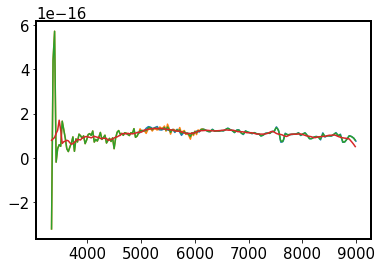

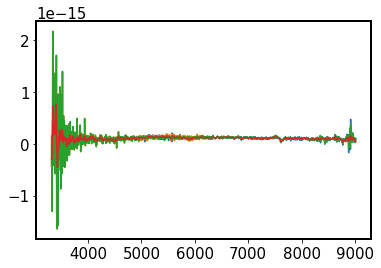

In [395]:
from astropy.convolution import convolve, Box1DKernel
imp.reload(func)
qso1_comb = func.combine_spectra(qso1_red_flux_1d_clean, 
                                 qso1_blue_flux_1d_clean)
header = qso1_red_2d[0].header # take from either exposures,
#  no need to average from red to blue .... 
func.write_final_spectrum(header, qso1_comb, '230427_J153355_qso1_combined_spec')


qso1_comb_bkgnd = func.combine_spectra(qso1_red_flux_1d_clean_bkgnd,
                                       qso1_blue_flux_1d_clean_bkgnd)
header = qso1_red_2d[0].header # take from either exposures,
#  no need to average from red to blue .... 
func.write_final_spectrum(header, qso1_comb_bkgnd, '230417_J153355_qso1_combined_spec_bkgnd')


In [400]:
for i in range(3):
    #mjd = sp[i][0].header['MJD']
    mjd_sdss = Time(sp[i][0].header['MJD'], format='mjd')
    print(mjd_sdss)

51989.0
51641.0
54561.0


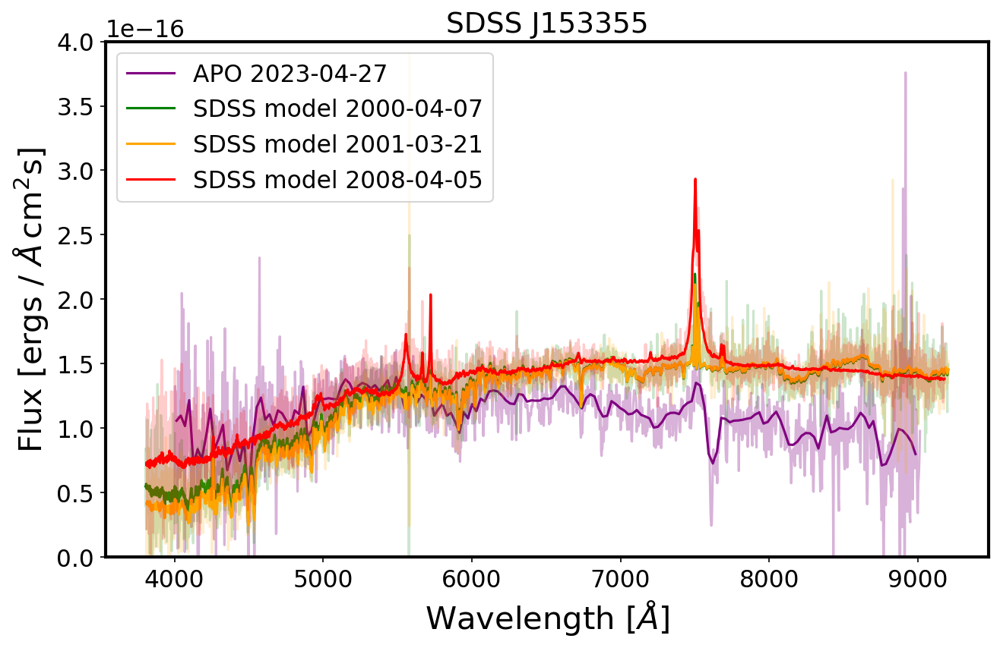

In [405]:
from astropy.time import Time

sp = sdss_spectra['153355.99+011029.7']
sp_sorted = [sp[1], sp[0], sp[2]]


sdss_colors = ['green', 'orange', 'red']
apo_color = 'purple'


from scipy.stats import binned_statistic
fig, ax = plt.subplots(1,1, figsize=(10,6), dpi=150, facecolor='w')

# plot the combined spectrum 
m = qso1_comb['wavelength'] > xmin
x = qso1_comb['wavelength'][m]
y = qso1_comb['flux'][m]
ax.plot(x, y, label='APO 2023-04-27',c=apo_color )
#ax.plot(x,convolve(y, Box1DKernel(2))) # very narrow 2px kernel... 

# plot the combined background
m = qso1_comb_bkgnd['wavelength'] > xmin
ax.plot(qso1_comb_bkgnd['wavelength'][m], 
        qso1_comb_bkgnd['flux'][m], #label='APO comb bkgnd' ,
       c=apo_color, alpha=0.3)


ax.set_title('Flux Calibrated Spectrum  SDSSJ153355.99+011029.7 red&blue')  
ax.set_ylim(0,0.4e-15)

for i in range(3):
    #mjd = sp[i][0].header['MJD']
    mjd_sdss = Time(sp_sorted[i][0].header['MJD'], format='mjd')
    #mjd_sdss = Time(hdul[0].header['MJD'], format='mjd')
    date_sdss = str(mjd_sdss.to_datetime()).split(' ')[0]
    spec = sp_sorted[i][1].data
    ax.plot(np.power(10,spec['loglam']), spec['flux']*1e-17, alpha=0.2,
           c=sdss_colors[i])
    ax.plot(np.power(10,spec['loglam']), spec['model']*1e-17, label=f'SDSS model {date_sdss}',
           c=sdss_colors[i])
    
ax.set_xlabel('Wavelength '+ r'$[\AA]$')
ax.set_ylabel('Flux [ergs / '+r'$\AA \, $cm$^{2}$s]')
ax.set_title('SDSS J153355')  
ax.legend()

Note: 51989 and 51641 are basically on top of each other 

Interestingly, with this CLQSO I don't see any of the strong lines https://skyserver.sdss.org/DR16//en/tools/explore/summary.aspx?id=1237651735780393162 links to https://dr16.sdss.org/optical/spectrum/view?plateid=363&mjd=51989&fiberid=575&run2d=26&zwarning=0&matches=any 

Both the Halpha and Hbeta are gone ... We see the return to the old levels.  
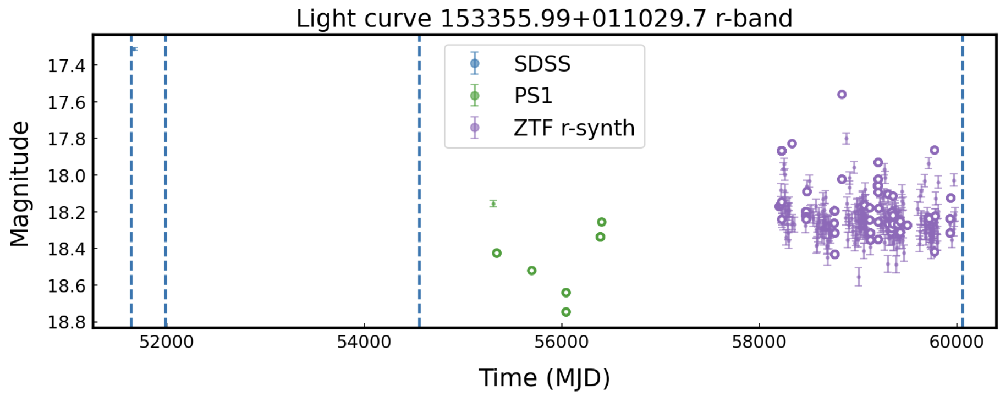
**Need to mark on a light curve when these spectra were taken. **

** I try 


or if I search 233.48331  1.17494  

## Compare the second QSO to SDSS:

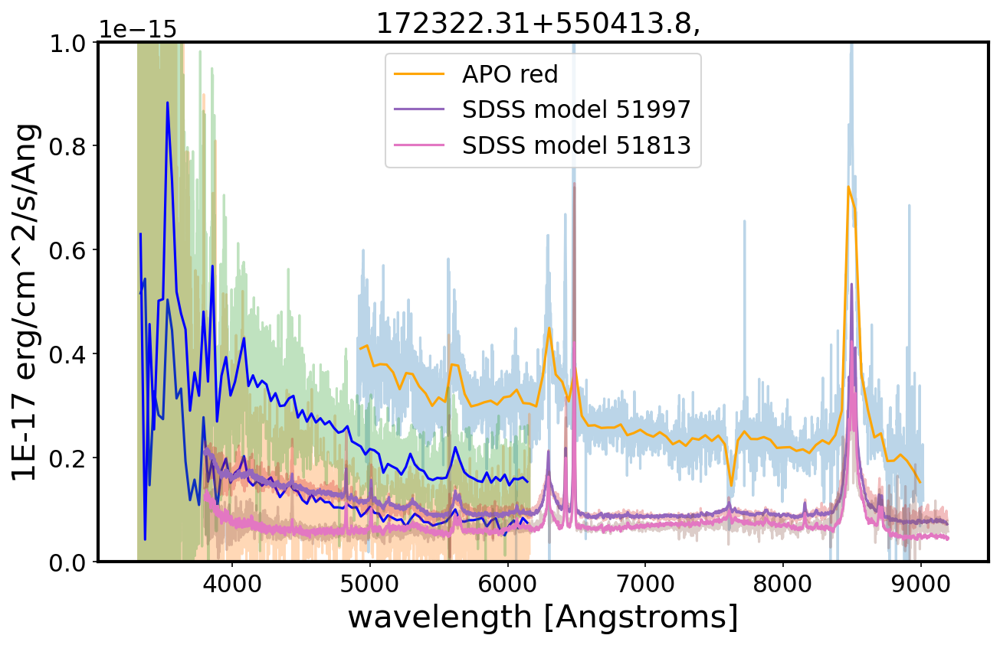

In [416]:
name = '172322.31+550413.8'
sp = sdss_spectra[name]

from scipy.stats import binned_statistic
fig, ax = plt.subplots(1,1, figsize=(10,6), dpi=150, facecolor='w')

# only one red exposure for the second QSO of the night 
x = qso2_red_1d_fluxcal[0].spectral_axis.value
y = qso2_red_1d_fluxcal[0].flux.value
statistic, bin_edges, binnumber = binned_statistic(x,y, statistic='median', bins=87)
bin_centers  =  (bin_edges[1:] + bin_edges[:-1] ) /2.
ax.plot(x,y, alpha=0.3)
ax.plot(bin_centers, statistic, c='orange', label='APO red')
    
# only use the first blue exposure as it's much cleaner ...
for i in range(2):
#i=1
    x = qso2_blue_1d_fluxcal[i].spectral_axis.value
    y = qso2_blue_1d_fluxcal[i].flux.value

    statistic, bin_edges, binnumber = binned_statistic(x,y, statistic='median', bins=87)
    bin_centers  =  (bin_edges[1:] + bin_edges[:-1] ) /2.
    ax.plot(x,y, alpha=0.3)
    ax.plot(bin_centers, statistic, c='blue')

ax.set_xlabel(qso2_red_1d_fluxcal[0].spectral_axis.unit)
ax.set_ylabel(qso2_red_1d_fluxcal[0].flux.unit)
#ax.set_title('Flux Calibrated Spectrum  SDSSJ172322.30+550413.8 red&blue')  
ax.set_ylim(0,0.1e-14)

for i in range(2):
    mjd = sp[i][0].header['MJD']
    spec = sp[i][1].data
    ax.plot(np.power(10,spec['loglam']), spec['flux']*1e-17, alpha=0.3)
    ax.plot(np.power(10,spec['loglam']), spec['model']*1e-17, label=f'SDSS model {mjd}')
    
ax.set_title(f'{name}, ')#mjd={mjd}',)
ax.set_xlabel('wavelength [Angstroms]')
ax.set_ylabel( sp[i][0].header['BUNIT'])
ax.legend()

Here we have one red and one blue exposures, so just use the median-averaging on each, scale, and then combine:

Returning only the median per bin as there is only one exposure
Returning only the median per bin as there is only one exposure
Returning only the median per bin as there is only one exposure
Returning only the median per bin as there is only one exposure


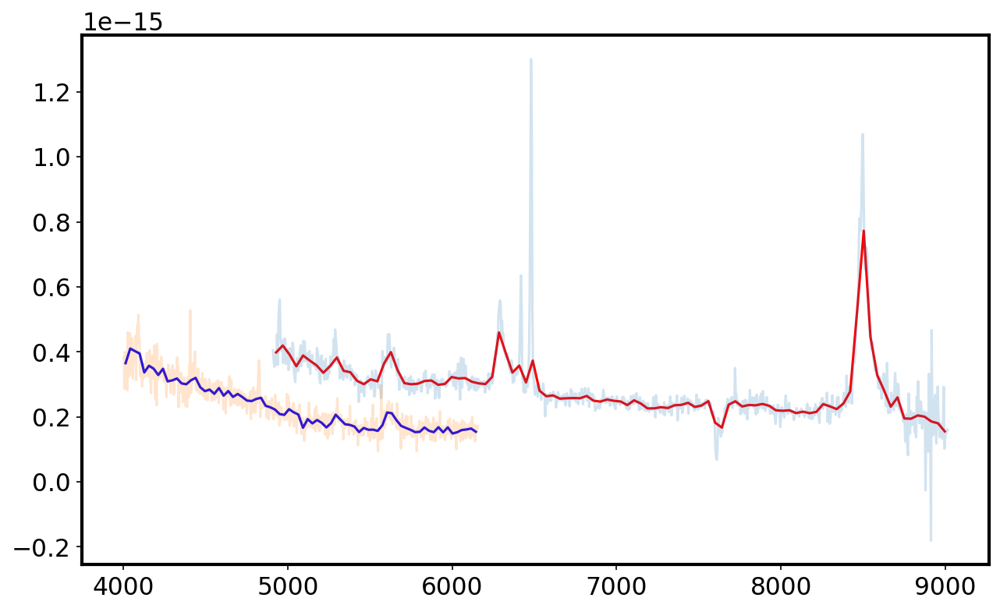

In [417]:
import functions as func
red_spectra = {}
i=0#for i in range(2):
red_spectra[i] = {}
red_spectra[i]['wavelength'] = qso2_red_1d_fluxcal[i].spectral_axis.value
red_spectra[i]['flux'] = qso2_red_1d_fluxcal[i].flux.value
result_red = func.median_n_exposures(red_spectra, Nbins=100)
result_red_bkgnd = func.median_n_exposures(red_spectra, Nbins=1000)

blue_spectra = {}

#for i in range(1): # only take the first exposure ... 
blue_spectra[0] = {}
blue_spectra[0]['wavelength'] = qso2_blue_1d_fluxcal[1].spectral_axis.value
blue_spectra[0]['flux'] = qso2_blue_1d_fluxcal[1].flux.value



result_blue = func.median_n_exposures(blue_spectra, Nbins=100)
result_blue_bkgnd = func.median_n_exposures(blue_spectra, Nbins=1000)


fig, ax = plt.subplots(1,1, figsize=(10,6), dpi=150, facecolor='w')
ax.plot(result_red['bins'], result_red['flux_med_per_bin'], c='red', label='APO 2023-01-14 red' )
ax.plot(result_red_bkgnd['bins'], result_red_bkgnd['flux_med_per_bin'], alpha=0.2)


# only plot blue above 4000 A ,,,,
xmin = 4000
m1 = result_blue['bins'] > xmin

ax.plot(np.array(result_blue['bins'])[m1], 
        np.array(result_blue['flux_med_per_bin'])[m1], c='blue', label='APO 2023-01-14 blue' )
m2 = result_blue_bkgnd['bins'] > xmin
ax.plot(np.array(result_blue_bkgnd['bins'])[m2],
        np.array(result_blue_bkgnd['flux_med_per_bin'])[m2], alpha=0.2)



In [419]:
# Scale 

qso2_blue_flux_calib_spec1d = func.spectrum1d(result_blue['bins'], # spectral_axis.value 
                                         result_blue['flux_med_per_bin'],#.flux.value
                                         error=result_blue['flux_std_per_bin'])# .uncertainty.array)
qso2_red_flux_calib_spec1d = func.spectrum1d(result_red['bins'],
                                        result_red['flux_med_per_bin'],
                                        error=result_red['flux_std_per_bin'])
qso2_red_flux_calib_spec1d_sca = func.scale_spectra(qso2_red_flux_calib_spec1d, 
                                               qso2_blue_flux_calib_spec1d)


qso2_blue_flux_calib_spec1d_bkgnd = func.spectrum1d(result_blue_bkgnd['bins'], # spectral_axis.value 
                                         result_blue_bkgnd['flux_med_per_bin'],#.flux.value
                                         error=result_blue_bkgnd['flux_std_per_bin'])# .uncertainty.array)
qso2_red_flux_calib_spec1d_bkgnd = func.spectrum1d(result_red_bkgnd['bins'],
                                        result_red_bkgnd['flux_med_per_bin'],
                                        error=result_red_bkgnd['flux_std_per_bin'])
qso2_red_flux_calib_spec1d_sca_bkgnd = func.scale_spectra(qso2_red_flux_calib_spec1d_bkgnd, 
                                               qso2_blue_flux_calib_spec1d_bkgnd)



# Combine 

# the scaled red spectrum 
qso2_red_flux_1d_clean = specutils.Spectrum1D(
                 spectral_axis=qso2_red_flux_calib_spec1d_sca.wave*u.angstrom,
                 flux = qso2_red_flux_calib_spec1d_sca.flux*u.Unit('erg cm-2 s-1 AA-1'), 
                 uncertainty= qso2_red_flux_calib_spec1d_sca.error)

# the original blue 
qso2_blue_flux_1d_clean = specutils.Spectrum1D(
    spectral_axis=qso2_blue_flux_calib_spec1d.wave*u.angstrom,
    flux = qso2_blue_flux_calib_spec1d.flux*u.Unit('erg cm-2 s-1 AA-1'), 
    uncertainty= qso2_blue_flux_calib_spec1d.error
)
# the scaled red bkgnd 
qso2_red_flux_1d_clean_bkgnd = specutils.Spectrum1D(
                 spectral_axis=qso2_red_flux_calib_spec1d_sca_bkgnd.wave*u.angstrom,
                 flux = qso2_red_flux_calib_spec1d_sca_bkgnd.flux*u.Unit('erg cm-2 s-1 AA-1'), 
                 uncertainty= qso2_red_flux_calib_spec1d_sca_bkgnd.error)

# the original blue 
qso2_blue_flux_1d_clean_bkgnd  = specutils.Spectrum1D(
    spectral_axis=qso2_blue_flux_calib_spec1d_bkgnd .wave*u.angstrom,
    flux = qso2_blue_flux_calib_spec1d_bkgnd .flux*u.Unit('erg cm-2 s-1 AA-1'), 
    uncertainty= qso2_blue_flux_calib_spec1d_bkgnd .error
)

INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]


41.083530446719124 28.401541248554167
4.108353044672185 2.8401541248554167


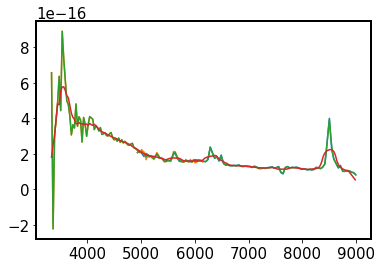

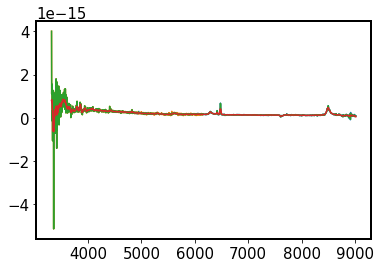

In [420]:
from astropy.convolution import convolve, Box1DKernel
imp.reload(func)
qso2_comb = func.combine_spectra(qso2_red_flux_1d_clean, 
                                 qso2_blue_flux_1d_clean)
header = qso2_red_2d[0].header # take from either exposures,
#  no need to average from red to blue .... 
func.write_final_spectrum(header, qso2_comb, '230427_J172322_qso2_combined_spec')


qso2_comb_bkgnd = func.combine_spectra(qso2_red_flux_1d_clean_bkgnd,
                                       qso2_blue_flux_1d_clean_bkgnd)
header = qso2_red_2d[0].header # take from either exposures,
#  no need to average from red to blue .... 
func.write_final_spectrum(header, qso2_comb_bkgnd, '230417_J172322_qso2_combined_spec_bkgnd')


(0.0, 7e-16)

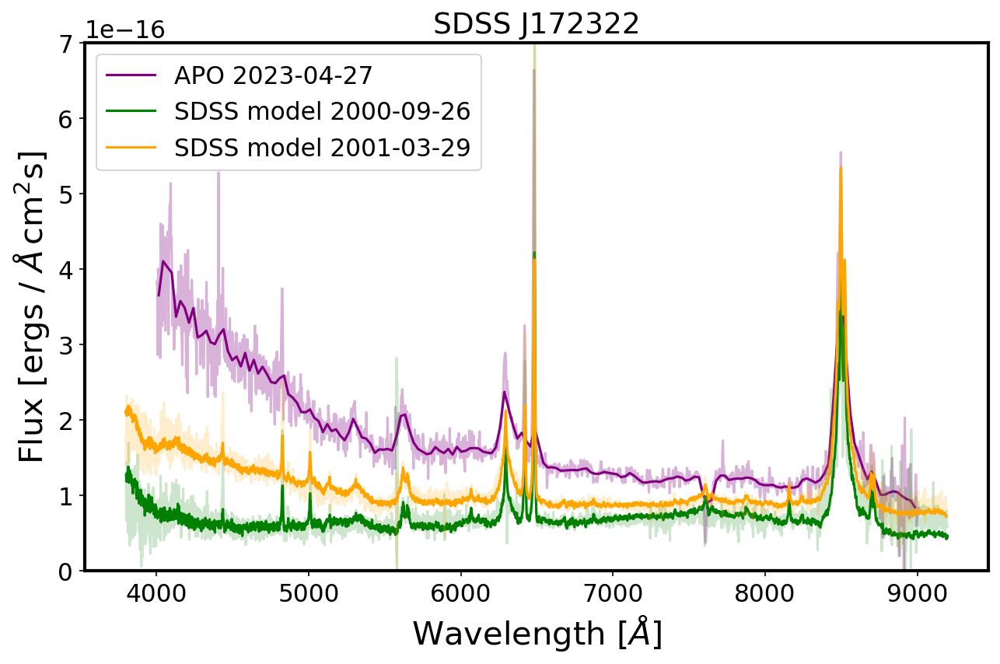

In [423]:
from astropy.time import Time
name = '172322.31+550413.8'
sp = sdss_spectra[name]
sp_sorted = [sp[1], sp[0]] # tp plot in the mjd order 


sdss_colors = ['green', 'orange', 'red']
apo_color = 'purple'


from scipy.stats import binned_statistic
fig, ax = plt.subplots(1,1, figsize=(10,6), dpi=150, facecolor='w')

# plot the combined spectrum 
m = qso2_comb['wavelength'] > xmin
x = qso2_comb['wavelength'][m]
y = qso2_comb['flux'][m]
ax.plot(x, y, label='APO 2023-04-27',c=apo_color )
#ax.plot(x,convolve(y, Box1DKernel(2))) # very narrow 2px kernel... 

# plot the combined background
m = qso2_comb_bkgnd['wavelength'] > xmin
ax.plot(qso2_comb_bkgnd['wavelength'][m], 
        qso2_comb_bkgnd['flux'][m], #label='APO comb bkgnd' ,
       c=apo_color, alpha=0.3)


for i in range(2):
    #mjd = sp[i][0].header['MJD']
    mjd_sdss = Time(sp_sorted[i][0].header['MJD'], format='mjd')
    #mjd_sdss = Time(hdul[0].header['MJD'], format='mjd')
    date_sdss = str(mjd_sdss.to_datetime()).split(' ')[0]
    spec = sp_sorted[i][1].data
    ax.plot(np.power(10,spec['loglam']), spec['flux']*1e-17, alpha=0.2,
           c=sdss_colors[i])
    ax.plot(np.power(10,spec['loglam']), spec['model']*1e-17, label=f'SDSS model {date_sdss}',
           c=sdss_colors[i])
    
ax.set_xlabel('Wavelength '+ r'$[\AA]$')
ax.set_ylabel('Flux [ergs / '+r'$\AA \, $cm$^{2}$s]')
ax.set_title('SDSS J172322')  
ax.legend()
ax.set_ylim(0,0.7e-15)

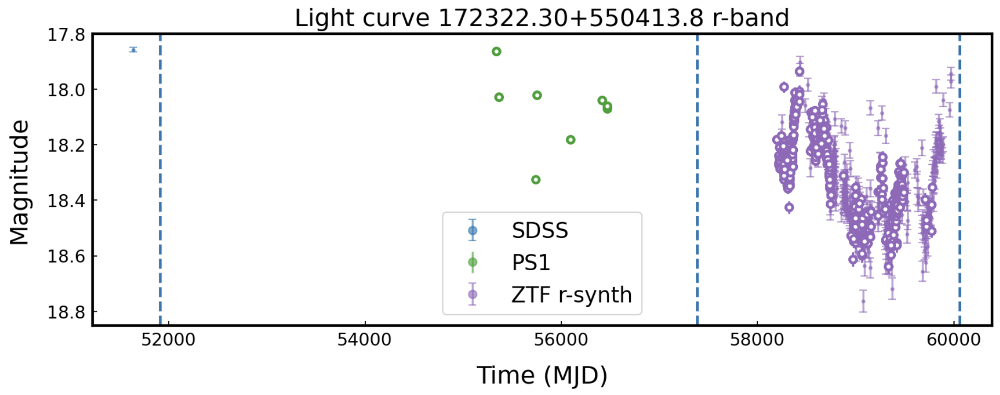

Interesting! Looks like I'n registering a very strong emission  - 

first epoch https://dr16.sdss.org/optical/spectrum/view?id=357608&plate=357&mjd=51813&fiberid=162
second epoch https://dr16.sdss.org/optical/spectrum/view?id=357609&plate=367&mjd=51997&fiberid=172 

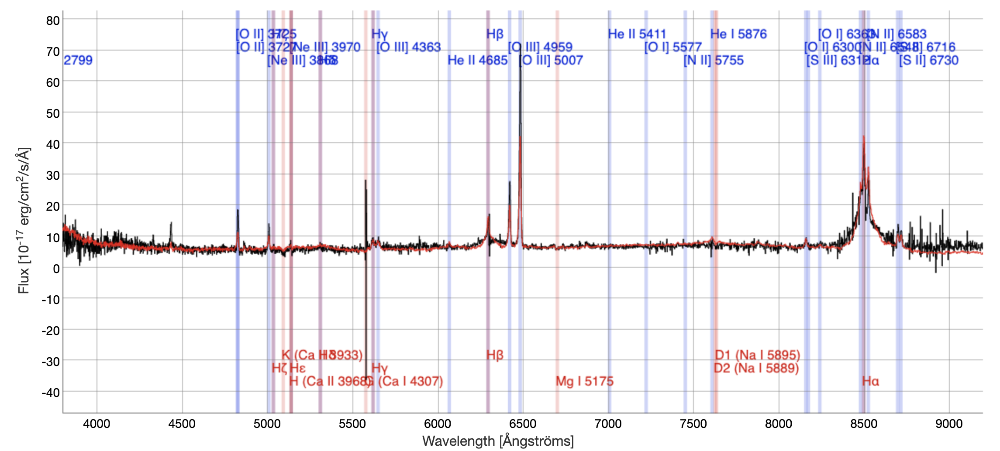

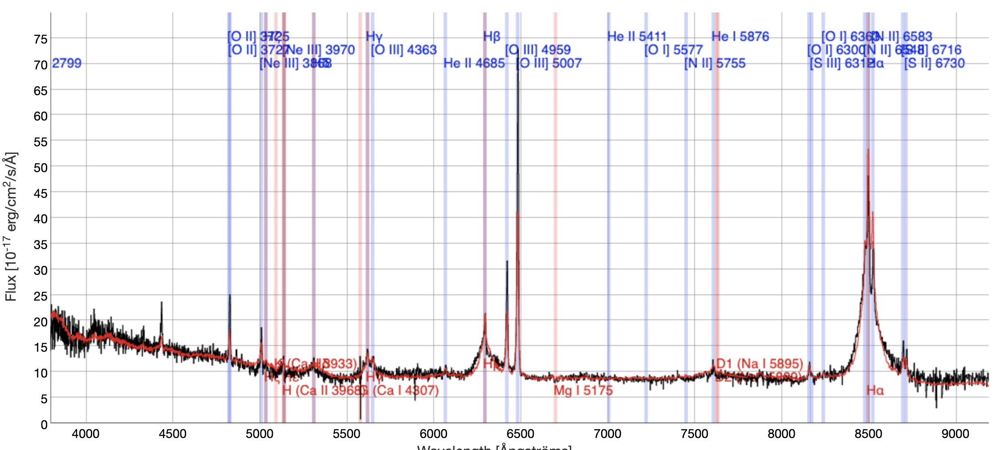